**Load Data**

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Linha corrigida
df = pd.read_csv('dataset/44.csv', sep=';')
#df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/44.csv')
#first description of the data
df.head()

,time_stamp,asset_id,id,train_test,status_type_id,sensor_0_avg,sensor_0_max,sensor_0_min,sensor_0_std,sensor_1_avg,...,wind_speed_236_min,wind_speed_236_std,wind_speed_235_avg,wind_speed_235_max,wind_speed_235_min,wind_speed_235_std,wind_speed_237_avg,wind_speed_237_max,wind_speed_237_min,wind_speed_237_std
0,2022-08-02 14:00:00,44,0,train,0,22.026,27.6,15.3,2.381,0.0044,...,3.85,0.7347,6.607,9.9,3.1,0.8705,6.813,10.1,2.7,0.9747
1,2022-08-02 14:10:00,44,1,train,0,21.170,25.7,15.3,1.947,-0.0125,...,3.70,0.7355,6.416,9.3,2.2,0.8920,6.618,9.6,2.8,0.9180
2,2022-08-02 14:20:00,44,2,train,0,18.990,25.3,13.0,2.928,0.0117,...,3.70,0.8943,6.174,10.7,2.4,0.9950,6.600,10.3,2.8,1.0780
3,2022-08-02 14:30:00,44,3,train,0,18.048,24.7,13.0,1.875,-0.0098,...,3.70,0.6885,5.925,8.2,2.4,0.7651,6.227,8.9,2.1,0.9643
4,2022-08-02 14:40:00,44,4,train,0,19.077,25.0,13.6,2.287,0.0056,...,2.80,0.7453,6.443,9.8,2.4,0.8538,6.608,9.6,1.0,0.9440


In [2]:
# Get the column names
column_names = df.columns.tolist()

# Print the column names
#column_names

# Split the Data in Months and Year

In [3]:
# Converter coluna de data para datetime
df['Date'] = pd.to_datetime(df['time_stamp'], format="%Y-%m-%d %H:%M:%S")

# Criar coluna de meses contínuos
start_date = df['Date'].min()
df['Month'] = (df['Date'].dt.year - start_date.year) * 12 + df['Date'].dt.month - start_date.month + 1

# Extrair também o ano, se quiser manter
df['Year'] = df['Date'].dt.year 

# Renomear a coluna de média de potência
df.rename(columns={'power_5_avg': 'LV ActivePower (kW)'}, inplace=True)

# Selecionar apenas colunas relevantes
new_data = df[['Month', 'Year', 'Date', 'LV ActivePower (kW)', 'wind_speed_235_avg']]

# Calcular a capacidade máxima
cap = new_data['LV ActivePower (kW)'].max()

# Visualizar dados
new_data


#cap

,Month,Year,Date,LV ActivePower (kW),wind_speed_235_avg
0,1,2022,2022-08-02 14:00:00,0.25032,6.607
1,1,2022,2022-08-02 14:10:00,0.24058,6.416
2,1,2022,2022-08-02 14:20:00,0.21610,6.174
3,1,2022,2022-08-02 14:30:00,0.20514,5.925
4,1,2022,2022-08-02 14:40:00,0.21706,6.443
...,...,...,...,...,...
62998,15,2023,2023-10-14 01:40:00,0.48766,7.669
62999,15,2023,2023-10-14 01:50:00,0.42062,7.277
63000,15,2023,2023-10-14 02:00:00,0.49204,7.746
63001,15,2023,2023-10-14 02:10:00,0.49202,7.678


# Null Values

In [4]:
new_data.describe()

,Month,Year,Date,LV ActivePower (kW),wind_speed_235_avg
count,63003.000000,63003.000000,63003,63003.000000,63003.000000
mean,7.745869,2022.653921,2023-03-09 08:10:00,0.359844,7.509023
min,1.000000,2022.000000,2022-08-02 14:00:00,-0.015779,0.000000
25%,4.000000,2022.000000,2022-11-19 23:05:00,0.051448,4.808500
50%,8.000000,2023.000000,2023-03-09 08:10:00,0.248880,6.657000
75%,11.000000,2023.000000,2023-06-26 17:15:00,0.634600,9.655500
max,15.000000,2023.000000,2023-10-14 02:20:00,1.029600,28.878000
std,4.166814,0.475722,NaN,0.341922,3.983525


In [5]:
new_data.isnull().sum()

Month                  0
Year                   0
Date                   0
LV ActivePower (kW)    0
wind_speed_235_avg     0
dtype: int64

# Visualization

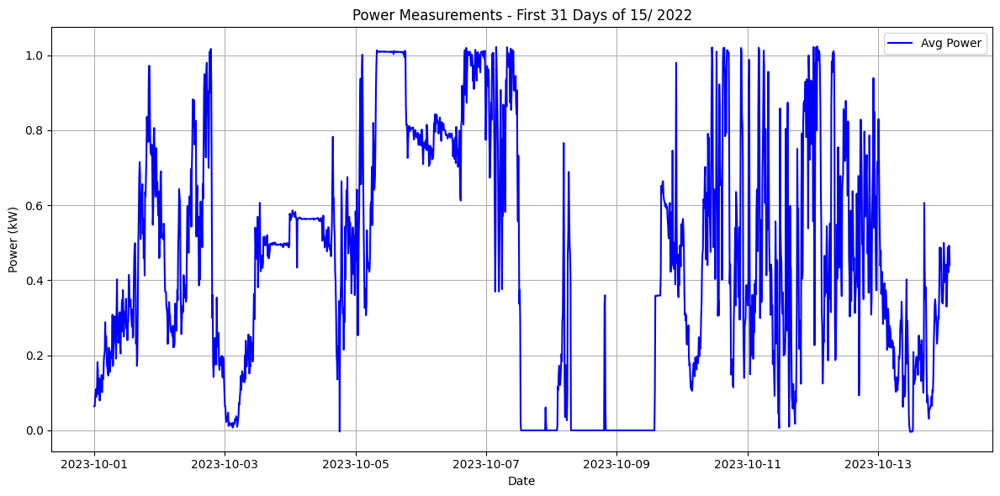

In [6]:
import matplotlib.pyplot as plt

# Parâmetros
month = 15
year = 2022
num_days = 31 # Altere aqui a quantidade de dias desejada

# Filtro base: mês e ano
filtered_data = new_data[(new_data['Month'] == month)]

# Pega os primeiros N dias únicos
first_n_days = filtered_data['Date'].dt.date.unique()[:num_days]

# Filtra apenas os dados desses dias
plot_data = filtered_data[filtered_data['Date'].dt.date.isin(first_n_days)]

# Plotando
plt.figure(figsize=(12, 6))

#plt.plot(plot_data['Date'], plot_data['power_5_min'], label='Min Power', color='red', linestyle='--')
plt.plot(plot_data['Date'], plot_data['LV ActivePower (kW)'], label='Avg Power', color='blue')
#plt.plot(plot_data['Date'], plot_data['power_5_max'], label='Max Power', color='green', linestyle='--')

# Personalização
plt.title(f'Power Measurements - First {num_days} Days of {month}/ {year}')
plt.xlabel('Date')
plt.ylabel('Power (kW)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

**Parameter Settings**

In [7]:
i=[1,2,3,4,5,6] #enter month value, i.e January = 1
look_back=6
data_partition=0.8

In [8]:
'''!pip install EMD-signal
!pip install tensorflow_docs
!pip install ewtpy
!pip install optuna'''

'!pip install EMD-signal\n!pip install tensorflow_docs\n!pip install ewtpy\n!pip install optuna'

In [9]:
from myfunctions import svr_model, svr_model_optuna,ann_model_optuna,ann_quantile_model_with_rri, rf_model,rf_model_optuna,lstm_model,bilstm_model,bilstm_att_model,cnn_bilstm_att_model, emd_lstm,eemd_lstm,ceemdan_lstm,proposed_method,cnn_bilstm_model,cnn_bilstm_model_with_optuna,cnn_bilstm_att_model_with_optuna

2025-10-24 17:29:00.608293: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1761326940.618147   27037 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1761326940.621551   27037 cuda_blas.cc:1407] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
W0000 00:00:1761326940.630476   27037 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1761326940.630485   27037 computation_placer.cc:177] computation placer already registered. Please check linkage and avoid linking the same target more than once.
W0000 00:00:1761326940.630487   27037 computation_placer.cc:177] computation placer alr

In [10]:
from myfunctions import proposed_method_bilstm,proposed_method_gru,proposed_method_bilstm_att,proposed_method_cnn_bilstm,proposed_method_cnn_bilstm_att, transformer_model,tft_model,lstm_model_with_optuna,bilstm_att_model_with_optuna,bilstm_model_with_optuna 

In [11]:
from myfunctions import proposed_method_bilstm_att_optuna,tft_model_with_optuna,transformer_model_with_optuna,proposed_method_bilstm_optuna,proposed_method_tft_aggregator, proposed_method_lstm_optuna,proposed_method_cnn_bilstm_att_optuna

In [12]:
CUDA_VISIBLE_DEVICES=""

--- EXECUTANDO SVR EM MODO DE TREINAMENTO (ANÁLISE DETERMINÍSTICA) ---
Treinando modelo SVR (previsão de ponto)...
Atribuindo previsão de ponto para todos os quantis (0.1, 0.5, 0.9)...
Modelo SVR e scalers salvos com sucesso.

===== Métricas Completas SVR (Previsão de Ponto) =====
Horizonte t+10: MAPE=4.7783%, RMSE=0.0826, MAE=0.0492, R²=0.9326
Horizonte t+20: MAPE=6.4537%, RMSE=0.1127, MAE=0.0664, R²=0.8744
Horizonte t+30: MAPE=7.3717%, RMSE=0.1239, MAE=0.0759, R²=0.8481


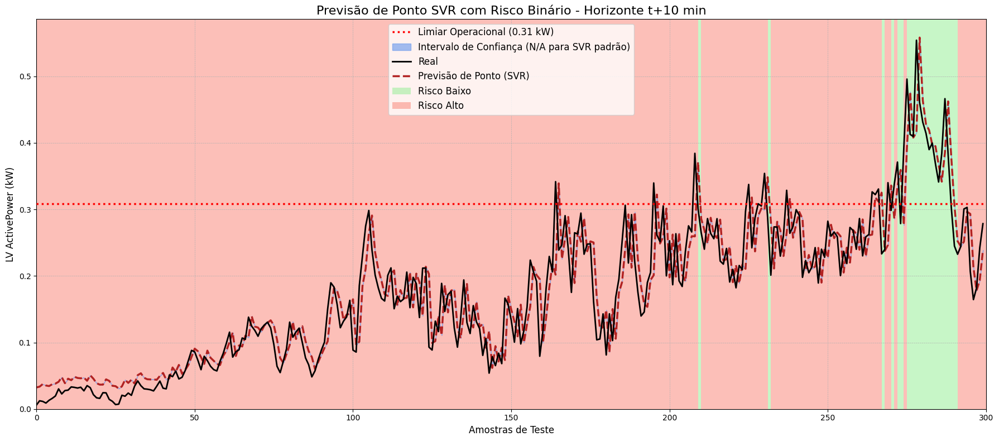

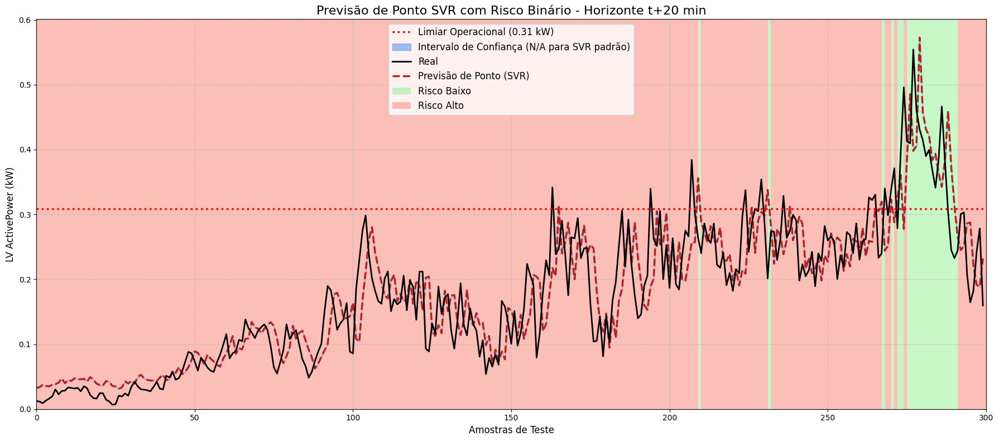

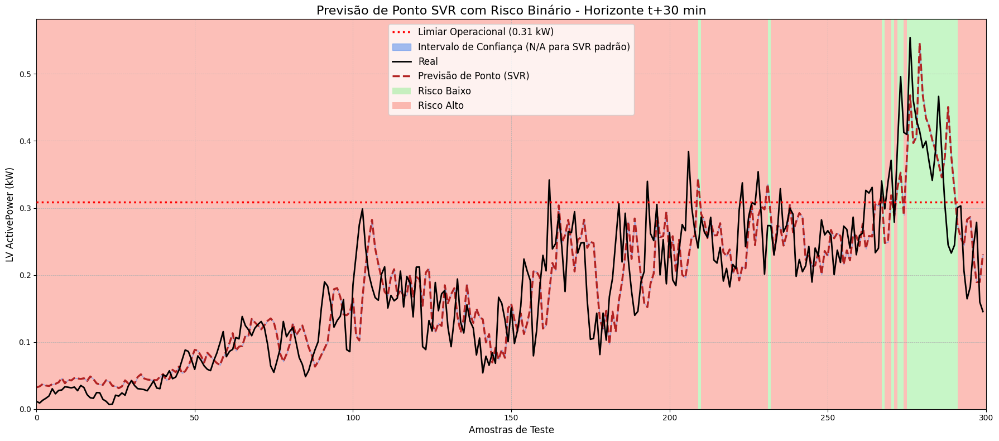

({0.1: array([[0.0324637 , 0.03267264, 0.03227011],
         [0.03364207, 0.03364945, 0.03377699],
         [0.03749746, 0.03752703, 0.03734761],
         ...,
         [0.80306387, 0.79680777, 0.79317995],
         [0.80284282, 0.79664795, 0.79296335],
         [0.80256134, 0.79636371, 0.79263172]]),
  0.5: array([[0.0324637 , 0.03267264, 0.03227011],
         [0.03364207, 0.03364945, 0.03377699],
         [0.03749746, 0.03752703, 0.03734761],
         ...,
         [0.80306387, 0.79680777, 0.79317995],
         [0.80284282, 0.79664795, 0.79296335],
         [0.80256134, 0.79636371, 0.79263172]]),
  0.9: array([[0.0324637 , 0.03267264, 0.03227011],
         [0.03364207, 0.03364945, 0.03377699],
         [0.03749746, 0.03752703, 0.03734761],
         ...,
         [0.80306387, 0.79680777, 0.79317995],
         [0.80284282, 0.79664795, 0.79296335],
         [0.80256134, 0.79636371, 0.79263172]])},
 array([[0.0060356, 0.0123626, 0.0114462],
        [0.0123626, 0.0114462, 0.0089552],
    

In [18]:
svr_model(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 12:45:06,787] A new study created in memory with name: no-name-14f4a6ec-eb6e-4a87-8236-8dbb18505121


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO SVR ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

[I 2025-10-24 12:45:10,981] Trial 6 finished with value: 16.317100335250526 and parameters: {'C': 2.2829133202613328, 'epsilon': 0.8124681596828304, 'gamma': 'scale'}. Best is trial 6 with value: 16.317100335250526.
[I 2025-10-24 12:45:33,410] Trial 8 finished with value: 6.4672759599592675 and parameters: {'C': 2.3271824150550797, 'epsilon': 0.1745160032149372, 'gamma': 'scale'}. Best is trial 8 with value: 6.4672759599592675.
[I 2025-10-24 12:45:44,725] Trial 16 finished with value: 6.017763019268472 and parameters: {'C': 0.1829137526510883, 'epsilon': 0.11069359608887916, 'gamma': 'scale'}. Best is trial 16 with value: 6.017763019268472.
[I 2025-10-24 12:45:48,724] Trial 18 finished with value: 16.64359273061725 and parameters: {'C': 4.3133158647236565, 'epsilon': 0.8312493366596446, 'gamma': 'auto'}. Best is trial 16 with value: 6.017763019268472.
[I 2025-10-24 12:45:57,890] Trial 17 finished with value: 12.74217995193566 and parameters: {'C': 148.26027412429286, 'epsilon': 0.63483

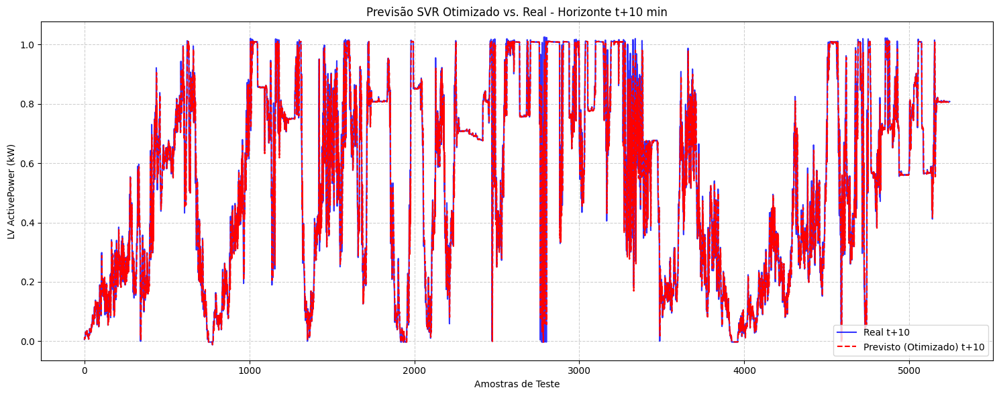

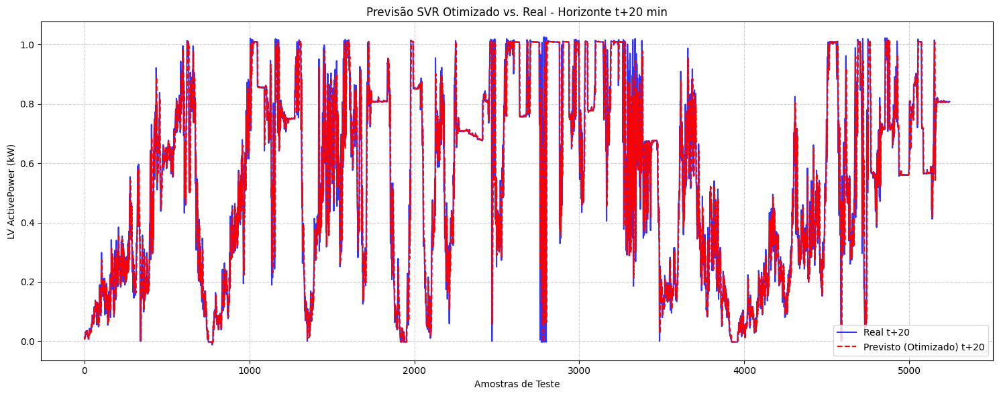

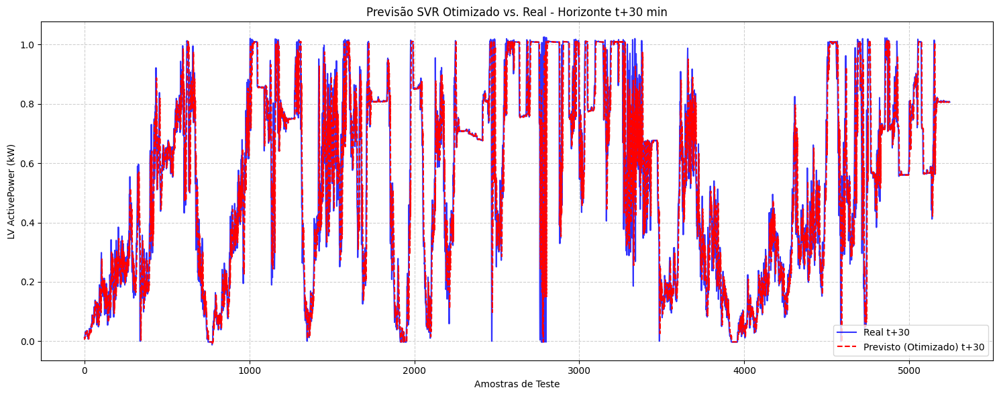

(MultiOutputRegressor(estimator=SVR(C=0.6997192627226148,
                                    epsilon=0.0010906250648233518,
                                    gamma='auto')),
 {'C': 0.6997192627226148, 'epsilon': 0.0010906250648233518, 'gamma': 'auto'},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.345910   0.081885  0.044745  0.933700
 1  t+20 min  6.037438   0.112220  0.062161  0.875422
 2  t+30 min  7.003908   0.125810  0.072112  0.843355)

In [12]:
svr_model_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO ANN EM MODO DE TREINAMENTO ---
Treinando modelo para o quantil: 0.1


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
I0000 00:00:1760030301.866511    3720 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
I0000 00:00:1760030304.217377   17911 service.cc:152] XLA service 0x7fd37400a1d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1760030304.217662   17911 service.cc:160]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
2025-10-09 17:18:24.285239: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, set env 

164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo salvo em: saved_models/ann_quantile/model_q01.keras
Treinando modelo para o quantil: 0.5


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo salvo em: saved_models/ann_quantile/model_q05.keras
Treinando modelo para o quantil: 0.9


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo salvo em: saved_models/ann_quantile/model_q09.keras
Scalers salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.8426%, RMSE=0.0835, MAE=0.0499, R²=0.9311
Horizonte t+20: MAPE=6.7419%, RMSE=0.1139, MAE=0.0694, R²=0.8716
Horizonte t+30: MAPE=7.4423%, RMSE=0.1278, MAE=0.0766, R²=0.8382


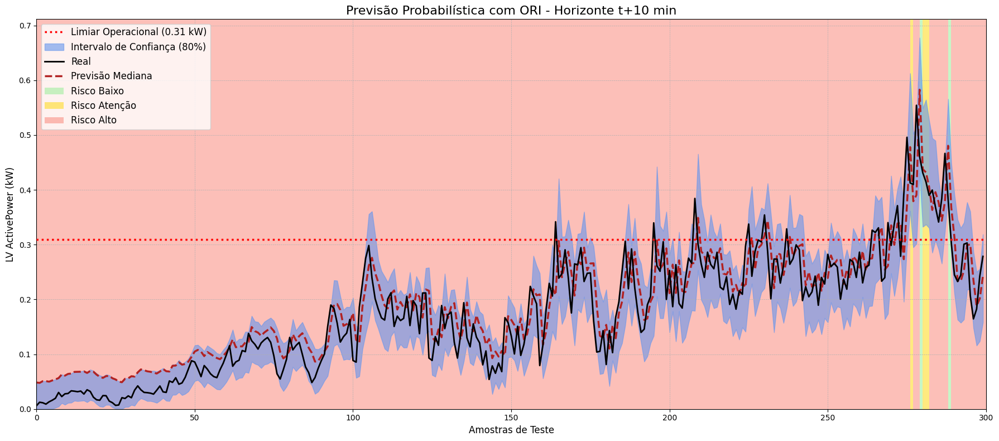

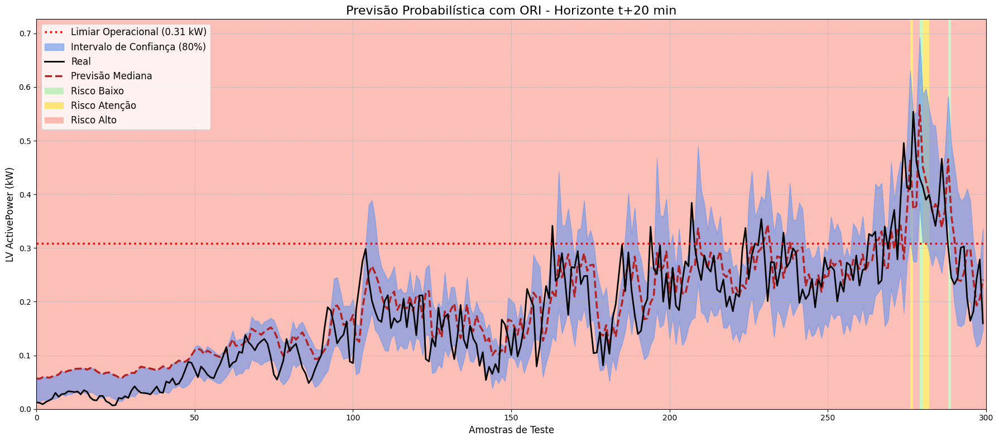

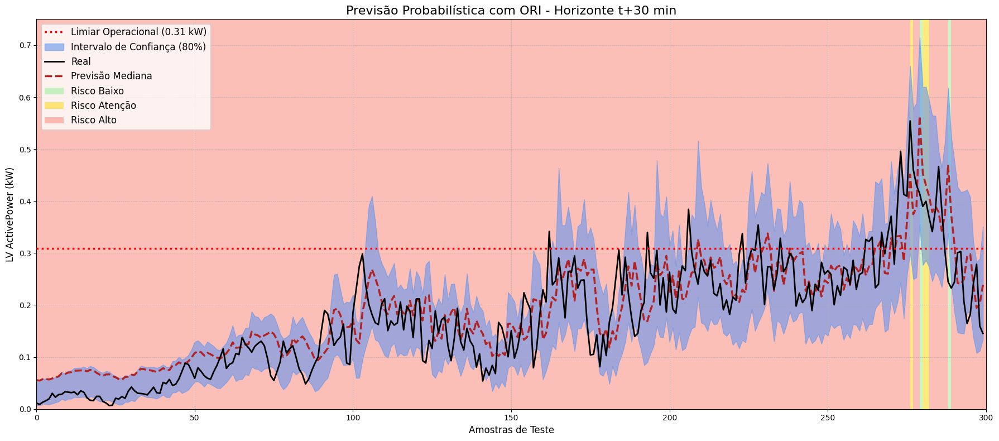

({0.1: array([[0.        , 0.01435788, 0.00769553],
         [0.        , 0.01376991, 0.00686464],
         [0.        , 0.01704173, 0.00978658],
         ...,
         [0.69797444, 0.7303114 , 0.7000835 ],
         [0.6979516 , 0.7303521 , 0.7000905 ],
         [0.6977056 , 0.7301173 , 0.6997477 ]], dtype=float32),
  0.5: array([[0.04841748, 0.05712546, 0.05558068],
         [0.04764101, 0.05628003, 0.05474401],
         [0.05084714, 0.05921559, 0.0575141 ],
         ...,
         [0.8199117 , 0.80221605, 0.82647735],
         [0.81975967, 0.8019896 , 0.82653356],
         [0.819485  , 0.8016265 , 0.8264498 ]], dtype=float32),
  0.9: array([[0.04841748, 0.05712546, 0.0567261 ],
         [0.04764101, 0.05628003, 0.05564138],
         [0.05084714, 0.05921559, 0.05768654],
         ...,
         [0.8657093 , 0.87864906, 0.88146406],
         [0.8657334 , 0.87871677, 0.8815208 ],
         [0.8655935 , 0.8786321 , 0.8814068 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [19]:
ann_quantile_model_with_rri(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 13:01:12,946] A new study created in memory with name: no-name-db2ab6e4-33db-47a5-b627-91db2a730b0a


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DA ANN ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA ANN COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
I0000 00:00:1761310873.449239   66941 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43629 MB memory:  -> device: 0, name: NVIDIA L40S, pci bus id: 0000:34:00.0, compute capability: 8.9
I0000 00:00:1761310875.437380   81488 service.cc:152] XLA service 0x7f96d80045e0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1761310875.437435   81488 service.cc:160]   StreamExecutor device (0): NVIDIA L40S, Compute Capability 8.9
2025-10-24 13:01:15.480438: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:269] disabling MLIR crash reproducer, se

[I 2025-10-24 13:01:48,511] Trial 0 finished with value: 8.10749533491134 and parameters: {'neurons_layer1': 32, 'neurons_layer2': 32, 'dropout_rate': 0.46148910152307787, 'learning_rate': 0.00014964000533846007, 'batch_size': 128}. Best is trial 0 with value: 8.10749533491134.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:02:50,235] Trial 1 finished with value: 6.237390545968222 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 64, 'dropout_rate': 0.45091669319251937, 'learning_rate': 0.0013813993213812647, 'batch_size': 32}. Best is trial 1 with value: 6.237390545968222.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:02:54.431360: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 12 bytes spill stores, 16 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/pyth

[I 2025-10-24 13:03:15,788] Trial 2 finished with value: 7.931064712695609 and parameters: {'neurons_layer1': 32, 'neurons_layer2': 128, 'dropout_rate': 0.2839744475347451, 'learning_rate': 0.004155039354638096, 'batch_size': 128}. Best is trial 1 with value: 6.237390545968222.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:03:52.720958: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_16', 4 bytes spill stores, 4 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python

[I 2025-10-24 13:04:51,076] Trial 3 finished with value: 6.096155776907875 and parameters: {'neurons_layer1': 128, 'neurons_layer2': 16, 'dropout_rate': 0.4464858149213866, 'learning_rate': 0.00011449383811339028, 'batch_size': 64}. Best is trial 3 with value: 6.096155776907875.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:06:15,089] Trial 4 finished with value: 6.0691571706288565 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.12457297268166179, 'learning_rate': 0.0012887790515542813, 'batch_size': 32}. Best is trial 4 with value: 6.0691571706288565.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:06:18.037801: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 148 bytes spill stores, 148 bytes spill loads

2025-10-24 13:06:18.518833: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument t

[I 2025-10-24 13:06:41,702] Trial 5 finished with value: 7.111998482270991 and parameters: {'neurons_layer1': 64, 'neurons_layer2': 128, 'dropout_rate': 0.37572641449718824, 'learning_rate': 0.0005067468637485893, 'batch_size': 128}. Best is trial 4 with value: 6.0691571706288565.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:06:45.476923: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python

[I 2025-10-24 13:07:08,879] Trial 6 finished with value: 6.743436238013366 and parameters: {'neurons_layer1': 64, 'neurons_layer2': 64, 'dropout_rate': 0.2902640430245321, 'learning_rate': 0.0005681087263506567, 'batch_size': 128}. Best is trial 4 with value: 6.0691571706288565.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:07:11.998748: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 4 bytes spill stores, 4 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python

[I 2025-10-24 13:08:30,303] Trial 7 finished with value: 6.137484396901182 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.48743077504643273, 'learning_rate': 0.0007069368220455038, 'batch_size': 32}. Best is trial 4 with value: 6.0691571706288565.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:08:33.696483: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads

2025-10-24 13:08:33.931664: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 104 bytes spill stores, 104 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument t

[I 2025-10-24 13:09:16,619] Trial 8 finished with value: 5.897963984824931 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 128, 'dropout_rate': 0.10057285706101503, 'learning_rate': 0.00025086683473832065, 'batch_size': 64}. Best is trial 8 with value: 5.897963984824931.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:10:32,103] Trial 9 finished with value: 5.985477986719274 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.34549014152514346, 'learning_rate': 0.0002699007782566938, 'batch_size': 32}. Best is trial 8 with value: 5.897963984824931.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:10:34.739503: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads

2025-10-24 13:10:34.917380: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 128 bytes spill stores, 128 bytes spill loads

2025-10-24 13:10:49.985728: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in func

[I 2025-10-24 13:11:37,075] Trial 10 finished with value: 6.24662163736352 and parameters: {'neurons_layer1': 128, 'neurons_layer2': 128, 'dropout_rate': 0.1035785280826367, 'learning_rate': 0.006109312786682779, 'batch_size': 64}. Best is trial 8 with value: 5.897963984824931.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:12:25,762] Trial 11 finished with value: 5.867651565843729 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.20791117403912884, 'learning_rate': 0.0003075248434531939, 'batch_size': 64}. Best is trial 11 with value: 5.867651565843729.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:13:12,088] Trial 12 finished with value: 5.845795557419703 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.19732417471253033, 'learning_rate': 0.00025378815449468085, 'batch_size': 64}. Best is trial 12 with value: 5.845795557419703.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:14:02,458] Trial 13 finished with value: 5.84119221508121 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.20574631335241117, 'learning_rate': 0.0003110767241388579, 'batch_size': 64}. Best is trial 13 with value: 5.84119221508121.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:14:59,114] Trial 14 finished with value: 5.750584326764344 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.18954450268915018, 'learning_rate': 0.00019090076231828066, 'batch_size': 64}. Best is trial 14 with value: 5.750584326764344.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:15:39,806] Trial 15 finished with value: 6.091921612459277 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 16, 'dropout_rate': 0.20599149905249406, 'learning_rate': 0.0021735561926611254, 'batch_size': 64}. Best is trial 14 with value: 5.750584326764344.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:16:51,016] Trial 16 finished with value: 6.592721087580419 and parameters: {'neurons_layer1': 32, 'neurons_layer2': 16, 'dropout_rate': 0.15608925199621287, 'learning_rate': 0.00015809764621167323, 'batch_size': 64}. Best is trial 14 with value: 5.750584326764344.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:17:46,512] Trial 17 finished with value: 6.032732881497407 and parameters: {'neurons_layer1': 64, 'neurons_layer2': 16, 'dropout_rate': 0.23227198230706017, 'learning_rate': 0.00048561143972430953, 'batch_size': 64}. Best is trial 14 with value: 5.750584326764344.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:17:49.672426: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads

2025-10-24 13:17:49.688708: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 12 bytes spill stores, 12 bytes spill loads

2025-10-24 13:17:49.912000: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in functi

[I 2025-10-24 13:18:39,805] Trial 18 finished with value: 5.945385743144738 and parameters: {'neurons_layer1': 128, 'neurons_layer2': 64, 'dropout_rate': 0.2647820294150832, 'learning_rate': 0.00017466287501255345, 'batch_size': 64}. Best is trial 14 with value: 5.750584326764344.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:18:42.804216: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 4 bytes spill stores, 4 bytes spill loads

2025-10-24 13:18:43.005108: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a 

[I 2025-10-24 13:19:58,475] Trial 19 finished with value: 5.752780376032663 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.16678429995713973, 'learning_rate': 0.00010784959804773089, 'batch_size': 64}. Best is trial 14 with value: 5.750584326764344.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:21:01,113] Trial 20 finished with value: 5.713475022491596 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.17050673083465284, 'learning_rate': 0.00010533245345497477, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:22:29,781] Trial 21 finished with value: 5.745031528297151 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.1582160325761841, 'learning_rate': 0.00011593822006137699, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:23:59,541] Trial 22 finished with value: 5.7628050005295535 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.15108869832778157, 'learning_rate': 0.00010638887300252053, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:25:07,995] Trial 23 finished with value: 5.8140480317204135 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.2512988266353715, 'learning_rate': 0.0001849189712577554, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:26:04,365] Trial 24 finished with value: 5.815318612773331 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.1691053600644949, 'learning_rate': 0.0001776715091055533, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:27:15,155] Trial 25 finished with value: 5.783255393195323 and parameters: {'neurons_layer1': 256, 'neurons_layer2': 32, 'dropout_rate': 0.13565781027542234, 'learning_rate': 0.00010352980075406142, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:27:54,146] Trial 26 finished with value: 7.330311360547737 and parameters: {'neurons_layer1': 32, 'neurons_layer2': 32, 'dropout_rate': 0.31619601256123464, 'learning_rate': 0.0003944252545308729, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:28:31,453] Trial 27 finished with value: 6.319546025529718 and parameters: {'neurons_layer1': 64, 'neurons_layer2': 32, 'dropout_rate': 0.18014185262790858, 'learning_rate': 0.0007692754307066598, 'batch_size': 64}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:30:11,643] Trial 28 finished with value: 6.099363991560448 and parameters: {'neurons_layer1': 128, 'neurons_layer2': 32, 'dropout_rate': 0.23595450592265882, 'learning_rate': 0.0002143749488767254, 'batch_size': 32}. Best is trial 20 with value: 5.713475022491596.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead

[I 2025-10-24 13:31:06,934] Trial 29 finished with value: 6.4617274811533845 and parameters: {'neurons_layer1': 32, 'neurons_layer2': 32, 'dropout_rate': 0.13172376948076533, 'learning_rate': 0.0001453345298792538, 'batch_size': 128}. Best is trial 20 with value: 5.713475022491596.

OTIMIZAÇÃO DA ANN CONCLUÍDA
Melhor resultado (MAPE médio na validação): 5.7135%

Hiperparâmetros Ótimos Encontrados:
  - neurons_layer1: 256
  - neurons_layer2: 32
  - dropout_rate: 0.17050673083465284
  - learning_rate: 0.00010533245345497477
  - batch_size: 64

--- TREINANDO MODELO ANN FINAL COM OS MELHORES PARÂMETROS ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/core/dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2025-10-24 13:31:10.484780: I external/local_xla/xla/stream_executor/cuda/subprocess_compilation.cc:346] ptxas warning : Registers are spilled to local memory in function 'gemm_fusion_dot_22', 8 bytes spill stores, 8 bytes spill loads



Epoch 88: early stopping
Restoring model weights from the end of the best epoch: 68.
Treinamento final concluído.

===== MÉTRICAS FINAIS NO CONJUNTO DE TESTE =====
Horizonte t+10: MAPE=4.4914%, RMSE=0.0812, MAE=0.0462, R²=0.9348
Horizonte t+20: MAPE=6.2032%, RMSE=0.1105, MAE=0.0639, R²=0.8792
Horizonte t+30: MAPE=7.1341%, RMSE=0.1238, MAE=0.0735, R²=0.8484

--- GERANDO GRÁFICOS DE RESULTADOS ---


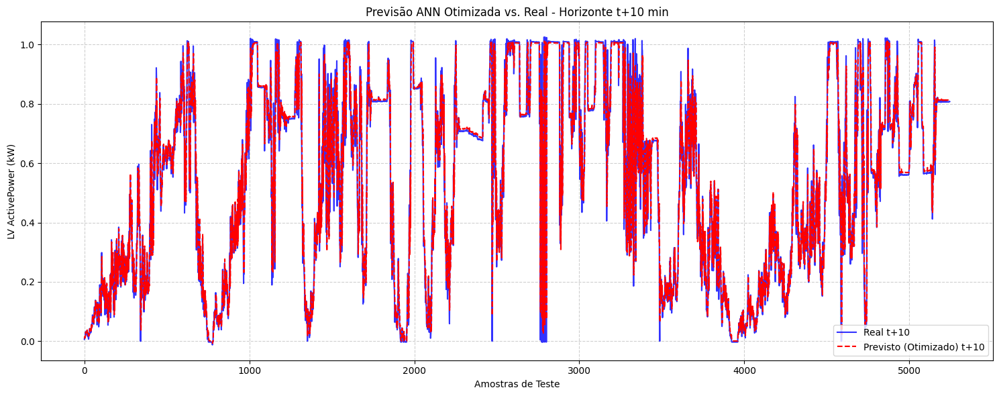

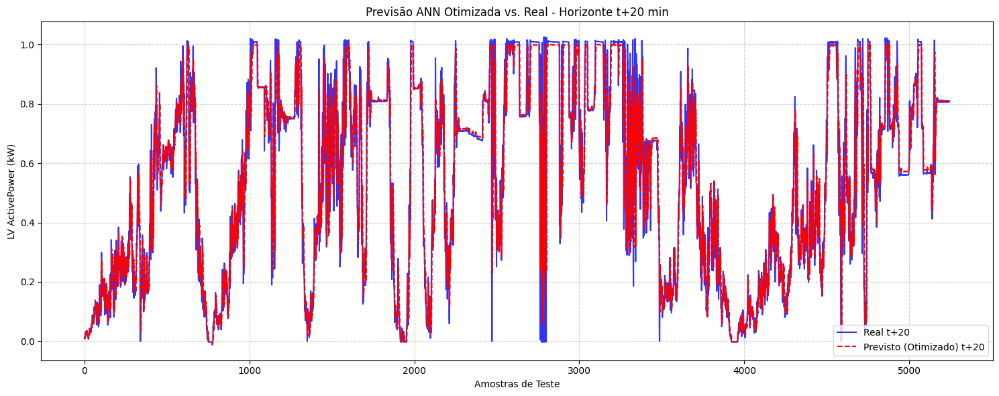

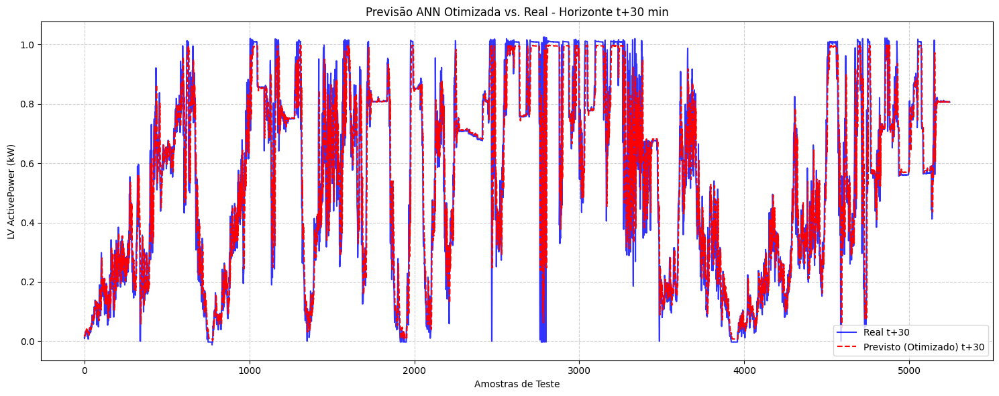

(<Sequential name=sequential, built=True>,
 {'neurons_layer1': 256,
  'neurons_layer2': 32,
  'dropout_rate': 0.17050673083465284,
  'learning_rate': 0.00010533245345497477,
  'batch_size': 64},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.491396   0.081212  0.046243  0.934784
 1  t+20 min  6.203151   0.110523  0.063868  0.879162
 2  t+30 min  7.134086   0.123758  0.073453  0.848423)

In [13]:
ann_model_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO RANDOM FOREST EM MODO DE TREINAMENTO ---
Treinando modelo Random Forest...
Modelo Random Forest e scalers salvos com sucesso.
Gerando previsões quantílicas a partir do ensemble Random Forest...
Aplicando correção de cruzamento de quantis...

===== Métricas Completas RF (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.5824%, RMSE=0.0846, MAE=0.0472, R²=0.9292
Horizonte t+20: MAPE=6.4460%, RMSE=0.1166, MAE=0.0664, R²=0.8654
Horizonte t+30: MAPE=7.4814%, RMSE=0.1317, MAE=0.0770, R²=0.8282


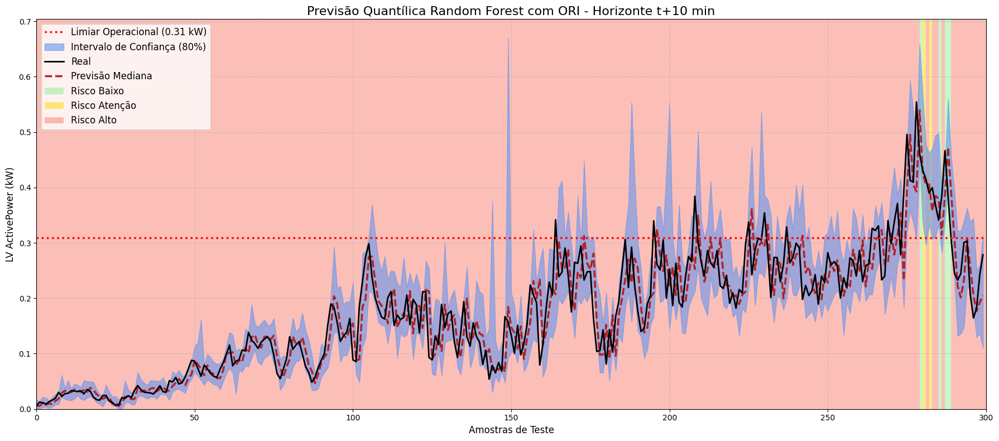

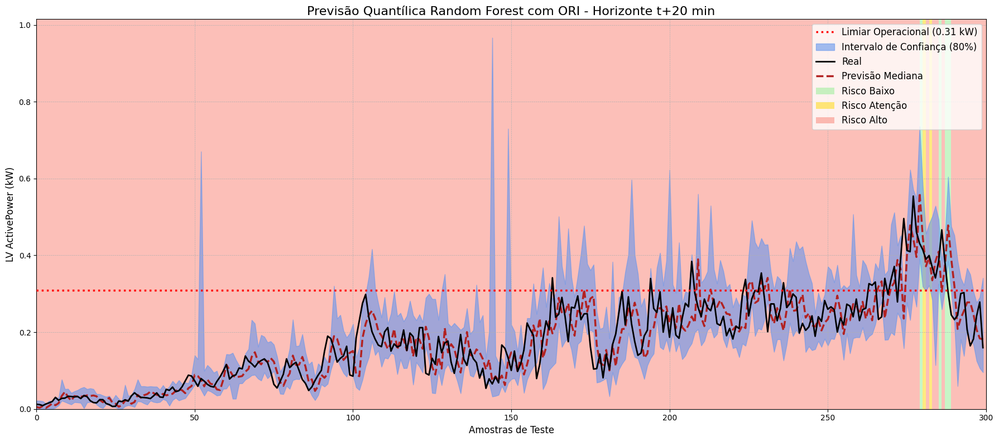

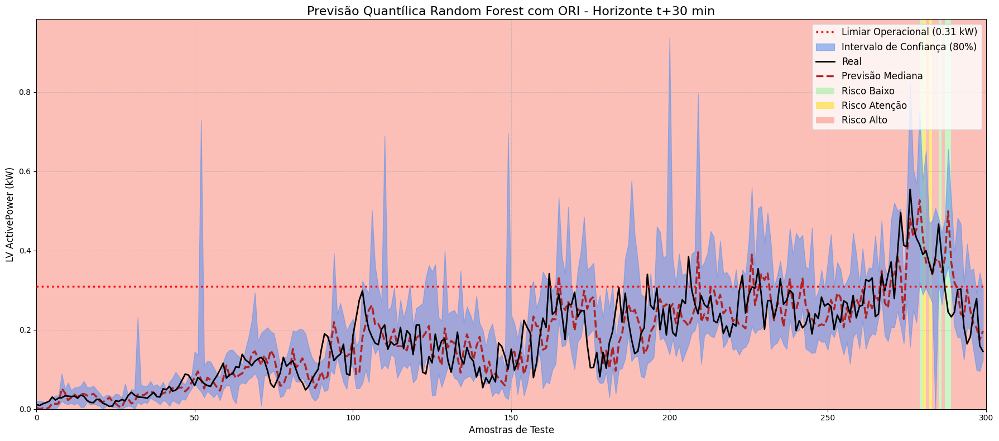

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.00392834, 0.        , 0.        ],
         ...,
         [0.779058  , 0.76648   , 0.721874  ],
         [0.779058  , 0.76648   , 0.721874  ],
         [0.7798    , 0.76648   , 0.721874  ]]),
  0.5: array([[0.0056662, 0.0054508, 0.0032454],
         [0.0056662, 0.0033124, 0.       ],
         [0.0108002, 0.0076718, 0.0020627],
         ...,
         [0.80034  , 0.79855  , 0.79656  ],
         [0.80115  , 0.79855  , 0.79656  ],
         [0.80196  , 0.80034  , 0.79664  ]]),
  0.9: array([[0.015762  , 0.02154   , 0.0203122 ],
         [0.01461628, 0.021446  , 0.0197305 ],
         [0.021446  , 0.0202356 , 0.01883208],
         ...,
         [0.89362   , 0.92916   , 0.94605   ],
         [0.883702  , 0.927342  , 0.94605   ],
         [0.883702  , 0.929664  , 0.9523    ]])},
 array([[0.0060356, 0.0123626, 0.0114462],
        [0.0123626, 0.0114462, 0.0089552],
        [0.0114462, 0.

In [20]:
rf_model(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 13:37:40,185] A new study created in memory with name: no-name-d5ad302e-2e50-4004-acb8-a060b89def88


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO RANDOM FOREST ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA RANDOM FOREST COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

[I 2025-10-24 13:37:42,514] Trial 0 finished with value: 6.07918685503527 and parameters: {'n_estimators': 161, 'max_depth': 44, 'min_samples_split': 9, 'min_samples_leaf': 2}. Best is trial 0 with value: 6.07918685503527.
[I 2025-10-24 13:37:45,850] Trial 1 finished with value: 5.860599772114075 and parameters: {'n_estimators': 377, 'max_depth': 9, 'min_samples_split': 11, 'min_samples_leaf': 4}. Best is trial 1 with value: 5.860599772114075.
[I 2025-10-24 13:37:48,884] Trial 2 finished with value: 6.077714447547649 and parameters: {'n_estimators': 209, 'max_depth': 31, 'min_samples_split': 11, 'min_samples_leaf': 1}. Best is trial 1 with value: 5.860599772114075.
[I 2025-10-24 13:37:50,290] Trial 3 finished with value: 5.914336224316059 and parameters: {'n_estimators': 138, 'max_depth': 11, 'min_samples_split': 9, 'min_samples_leaf': 6}. Best is trial 1 with value: 5.860599772114075.
[I 2025-10-24 13:37:51,831] Trial 4 finished with value: 5.987984487402977 and parameters: {'n_estima

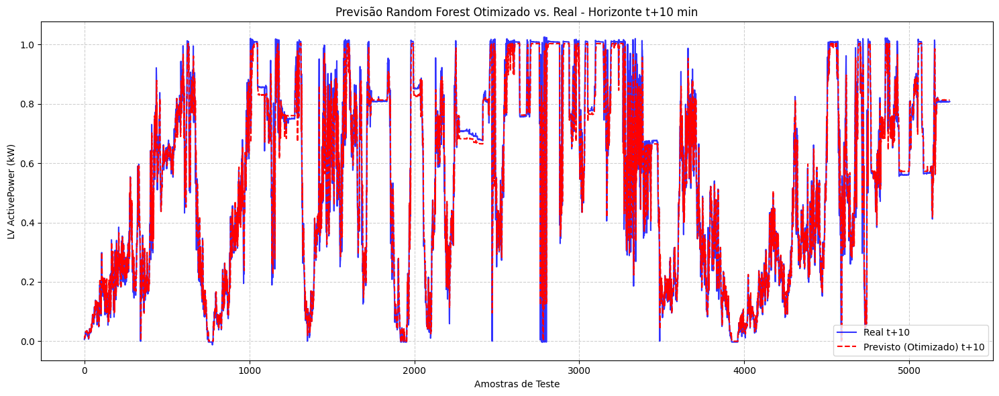

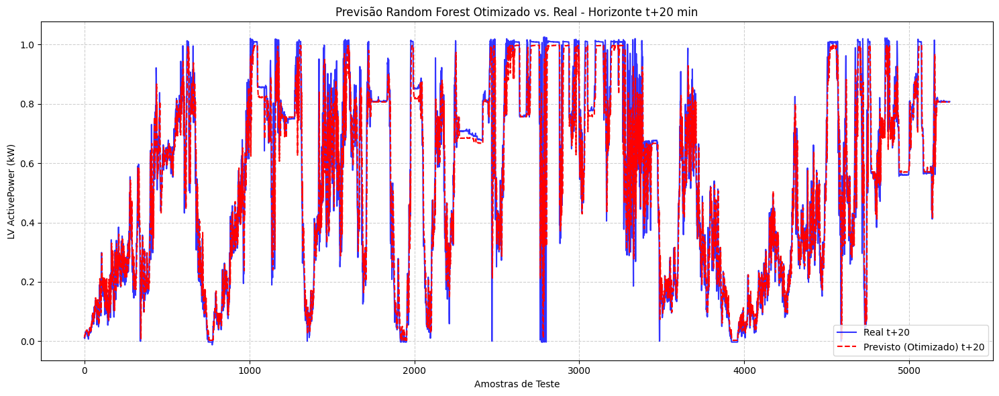

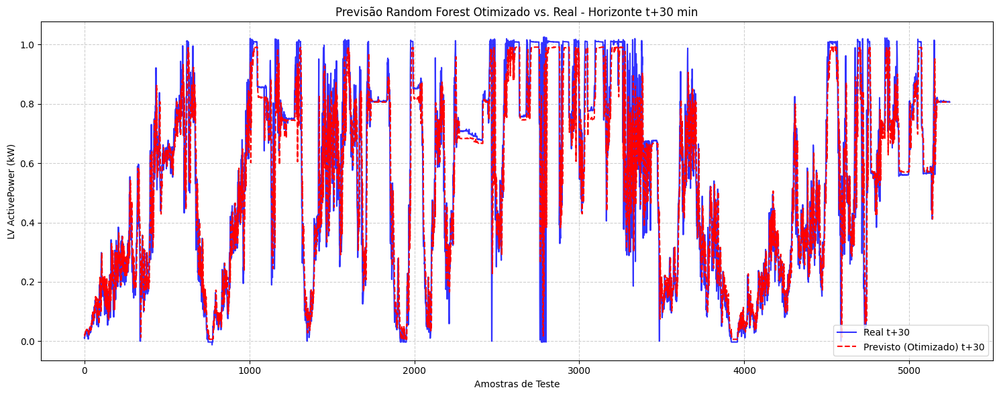

(RandomForestRegressor(max_depth=7, min_samples_leaf=7, min_samples_split=12,
                       n_estimators=315, n_jobs=-1, random_state=42),
 {'n_estimators': 315,
  'max_depth': 7,
  'min_samples_split': 12,
  'min_samples_leaf': 7},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.644362   0.081490  0.047818  0.934337
 1  t+20 min  6.369105   0.110629  0.065576  0.878930
 2  t+30 min  7.413236   0.123792  0.076327  0.848340)

In [14]:
rf_model_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO LSTM EM MODO DE TREINAMENTO ---
Treinando modelo LSTM para o quantil: 0.1


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo LSTM salvo em: saved_models/lstm_model/model_q01.keras
Treinando modelo LSTM para o quantil: 0.5


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo LSTM salvo em: saved_models/lstm_model/model_q05.keras
Treinando modelo LSTM para o quantil: 0.9


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step
Modelo LSTM salvo em: saved_models/lstm_model/model_q09.keras
Scalers para LSTM salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas LSTM (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.4261%, RMSE=0.0819, MAE=0.0456, R²=0.9336
Horizonte t+20: MAPE=6.1121%, RMSE=0.1126, MAE=0.0629, R²=0.8745
Horizonte t+30: MAPE=7.1643%, RMSE=0.1270, MAE=0.0738, R²=0.8405


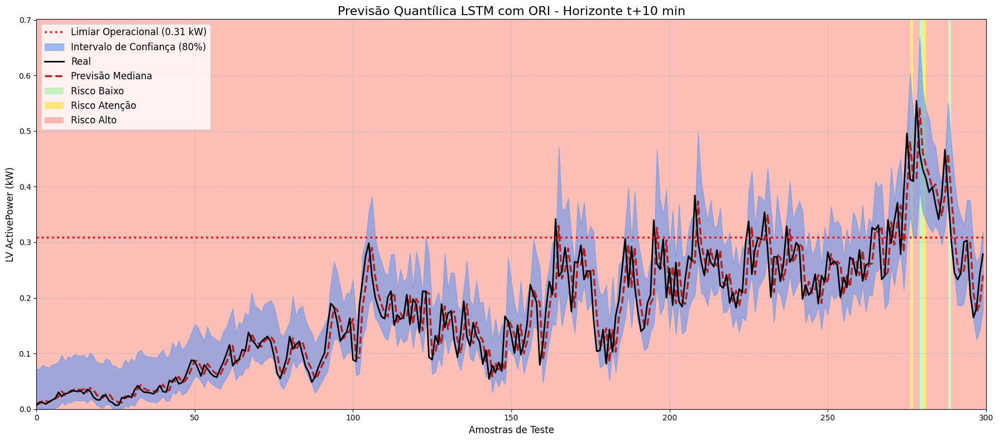

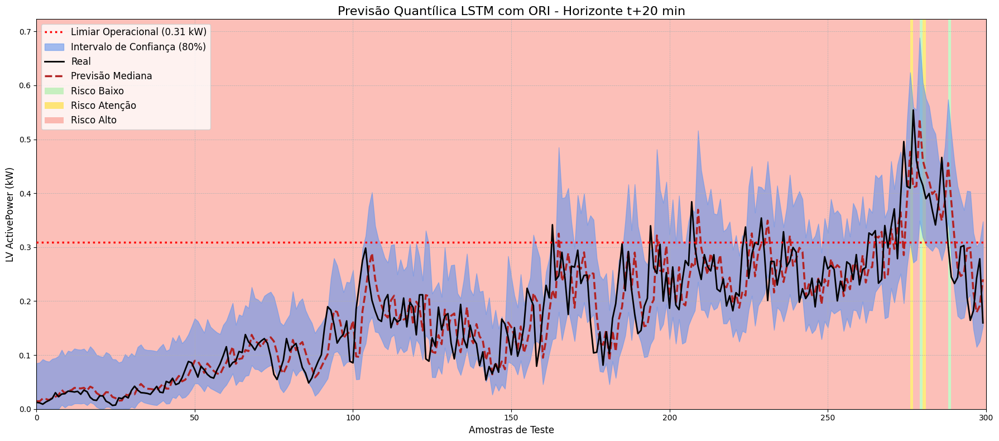

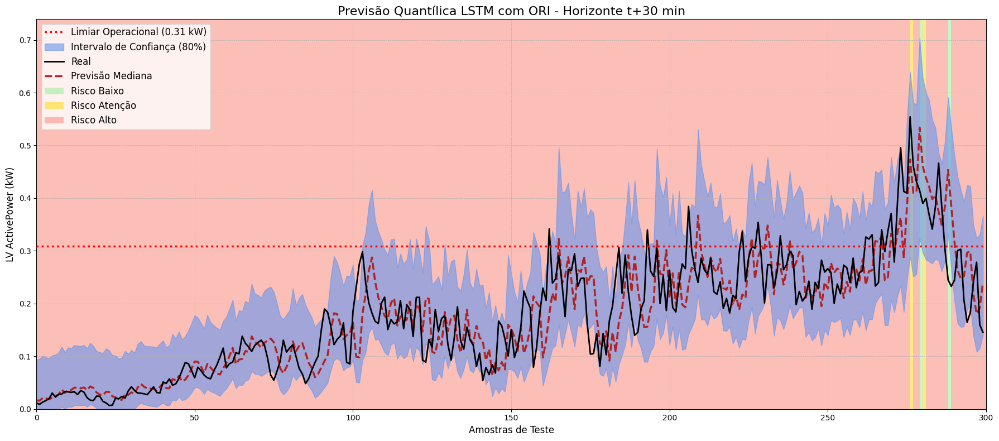

({0.1: array([[0.       , 0.       , 0.       ],
         [0.       , 0.       , 0.       ],
         [0.       , 0.       , 0.       ],
         ...,
         [0.7534766, 0.7347801, 0.7166418],
         [0.7532761, 0.7345676, 0.7164266],
         [0.7529341, 0.7342122, 0.716069 ]], dtype=float32),
  0.5: array([[0.01056978, 0.01480208, 0.01651922],
         [0.01002094, 0.01421811, 0.01592219],
         [0.01565436, 0.01951577, 0.02107528],
         ...,
         [0.8114004 , 0.80816734, 0.8044547 ],
         [0.81124014, 0.8080203 , 0.80431336],
         [0.81094986, 0.8077429 , 0.80404174]], dtype=float32),
  0.9: array([[0.07108098, 0.08480547, 0.09382743],
         [0.07250413, 0.08600663, 0.09494352],
         [0.07925731, 0.09219326, 0.10086912],
         ...,
         [0.8714282 , 0.8837866 , 0.8941016 ],
         [0.87130576, 0.8836868 , 0.89401364],
         [0.8710243 , 0.8834394 , 0.8937845 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
        [0.0123626, 

In [21]:
lstm_model(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 13:42:38,591] A new study created in memory with name: no-name-75727df3-9eeb-4567-9cf1-21aff46e768f


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO LSTM ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA LSTM COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:45:18,216] Trial 0 finished with value: 5.804026846688077 and parameters: {'lstm_units': 128, 'dropout_rate': 0.3167789458910524, 'learning_rate': 0.00041398165906460016, 'batch_size': 64}. Best is trial 0 with value: 5.804026846688077.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:48:16,205] Trial 1 finished with value: 5.772147112551319 and parameters: {'lstm_units': 32, 'dropout_rate': 0.13042539419592258, 'learning_rate': 0.0004217028456891527, 'batch_size': 64}. Best is trial 1 with value: 5.772147112551319.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:49:29,265] Trial 2 finished with value: 5.757111916540872 and parameters: {'lstm_units': 64, 'dropout_rate': 0.12470380171059432, 'learning_rate': 0.009289298168835235, 'batch_size': 128}. Best is trial 2 with value: 5.757111916540872.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:50:35,006] Trial 3 finished with value: 6.27138769868121 and parameters: {'lstm_units': 32, 'dropout_rate': 0.336804358735869, 'learning_rate': 0.0038944367750545373, 'batch_size': 64}. Best is trial 2 with value: 5.757111916540872.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:51:39,021] Trial 4 finished with value: 5.786745279536915 and parameters: {'lstm_units': 128, 'dropout_rate': 0.23492337140284467, 'learning_rate': 0.008808811366654382, 'batch_size': 128}. Best is trial 2 with value: 5.757111916540872.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:52:13,260] Trial 5 finished with value: 5.72631461498824 and parameters: {'lstm_units': 256, 'dropout_rate': 0.34027513138401116, 'learning_rate': 0.0068881517174374145, 'batch_size': 128}. Best is trial 5 with value: 5.72631461498824.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:54:43,981] Trial 6 finished with value: 5.767210242246027 and parameters: {'lstm_units': 128, 'dropout_rate': 0.33649586486505223, 'learning_rate': 0.00023084987718209292, 'batch_size': 128}. Best is trial 5 with value: 5.72631461498824.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:55:57,955] Trial 7 finished with value: 5.905572261525321 and parameters: {'lstm_units': 64, 'dropout_rate': 0.3739121467844313, 'learning_rate': 0.0010744142781493999, 'batch_size': 128}. Best is trial 5 with value: 5.72631461498824.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:57:14,733] Trial 8 finished with value: 5.674729602690658 and parameters: {'lstm_units': 128, 'dropout_rate': 0.22760734633943003, 'learning_rate': 0.0009238947460667959, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 13:59:08,184] Trial 9 finished with value: 6.226269020011107 and parameters: {'lstm_units': 256, 'dropout_rate': 0.43192709100338333, 'learning_rate': 0.0025519263615500568, 'batch_size': 64}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:04:38,696] Trial 10 finished with value: 5.79862701159745 and parameters: {'lstm_units': 128, 'dropout_rate': 0.21994368263851094, 'learning_rate': 0.00010632527638009231, 'batch_size': 32}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:05:16,995] Trial 11 finished with value: 5.831677348120704 and parameters: {'lstm_units': 256, 'dropout_rate': 0.2342472905067109, 'learning_rate': 0.0013987568144102822, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:08:44,025] Trial 12 finished with value: 6.086549357106979 and parameters: {'lstm_units': 256, 'dropout_rate': 0.4824318738566203, 'learning_rate': 0.00270888327014136, 'batch_size': 32}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:09:41,136] Trial 13 finished with value: 5.762391835124878 and parameters: {'lstm_units': 256, 'dropout_rate': 0.27090888356382253, 'learning_rate': 0.0007244743627672799, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:11:32,472] Trial 14 finished with value: 5.759302962002018 and parameters: {'lstm_units': 128, 'dropout_rate': 0.40005796705136615, 'learning_rate': 0.004660741937531456, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:12:09,756] Trial 15 finished with value: 5.832371448898009 and parameters: {'lstm_units': 256, 'dropout_rate': 0.1689142032224374, 'learning_rate': 0.001398458256115676, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:15:46,659] Trial 16 finished with value: 5.945948322612582 and parameters: {'lstm_units': 32, 'dropout_rate': 0.2779836148698371, 'learning_rate': 0.0006003574456913885, 'batch_size': 32}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:16:38,274] Trial 17 finished with value: 5.720757543189855 and parameters: {'lstm_units': 64, 'dropout_rate': 0.18833449915610193, 'learning_rate': 0.0020088909549020205, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:17:45,436] Trial 18 finished with value: 5.688579277342718 and parameters: {'lstm_units': 64, 'dropout_rate': 0.18220981126996053, 'learning_rate': 0.0019751624986804935, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:23:27,770] Trial 19 finished with value: 5.792074332117083 and parameters: {'lstm_units': 64, 'dropout_rate': 0.10017294681021463, 'learning_rate': 0.0002494397376535564, 'batch_size': 32}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:24:41,225] Trial 20 finished with value: 5.84421901549272 and parameters: {'lstm_units': 64, 'dropout_rate': 0.1952501089891086, 'learning_rate': 0.0009006201019494881, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:26:53,036] Trial 21 finished with value: 5.744377402129655 and parameters: {'lstm_units': 64, 'dropout_rate': 0.1706406196139865, 'learning_rate': 0.0018428252967933757, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:28:06,095] Trial 22 finished with value: 5.7036383216837265 and parameters: {'lstm_units': 64, 'dropout_rate': 0.17767586326764703, 'learning_rate': 0.0022047844257903665, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:29:37,038] Trial 23 finished with value: 5.8335987442530985 and parameters: {'lstm_units': 64, 'dropout_rate': 0.26925177979389014, 'learning_rate': 0.003790769317086738, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:31:01,739] Trial 24 finished with value: 5.677774428179936 and parameters: {'lstm_units': 64, 'dropout_rate': 0.15409192900176463, 'learning_rate': 0.001295673957631206, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:32:01,804] Trial 25 finished with value: 5.702404355721387 and parameters: {'lstm_units': 128, 'dropout_rate': 0.14432253826268698, 'learning_rate': 0.0012491183342233673, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:33:26,375] Trial 26 finished with value: 5.880950717714497 and parameters: {'lstm_units': 64, 'dropout_rate': 0.21145711864447406, 'learning_rate': 0.0005683097118246386, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:35:02,233] Trial 27 finished with value: 5.821892065620321 and parameters: {'lstm_units': 64, 'dropout_rate': 0.24831718797905944, 'learning_rate': 0.0009626133062436198, 'batch_size': 128}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:36:15,614] Trial 28 finished with value: 6.1348067440485226 and parameters: {'lstm_units': 128, 'dropout_rate': 0.14977573285787116, 'learning_rate': 0.00162836835883503, 'batch_size': 64}. Best is trial 8 with value: 5.674729602690658.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:39:19,474] Trial 29 finished with value: 5.896060245725675 and parameters: {'lstm_units': 128, 'dropout_rate': 0.1139961484259246, 'learning_rate': 0.0003120202667001965, 'batch_size': 32}. Best is trial 8 with value: 5.674729602690658.

OTIMIZAÇÃO DO LSTM CONCLUÍDA
Melhor resultado (MAPE médio na validação): 5.6747%

Hiperparâmetros Ótimos Encontrados:
  - lstm_units: 128
  - dropout_rate: 0.22760734633943003
  - learning_rate: 0.0009238947460667959
  - batch_size: 128

--- TREINANDO MODELO LSTM FINAL COM OS MELHORES PARÂMETROS ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 52: early stopping
Restoring model weights from the end of the best epoch: 32.
Treinamento final concluído.

===== MÉTRICAS FINAIS NO CONJUNTO DE TESTE =====
Horizonte t+10: MAPE=4.7812%, RMSE=0.0809, MAE=0.0492, R²=0.9352
Horizonte t+20: MAPE=6.6781%, RMSE=0.1108, MAE=0.0688, R²=0.8785
Horizonte t+30: MAPE=7.8068%, RMSE=0.1245, MAE=0.0804, R²=0.8465

--- GERANDO GRÁFICOS DE RESULTADOS ---


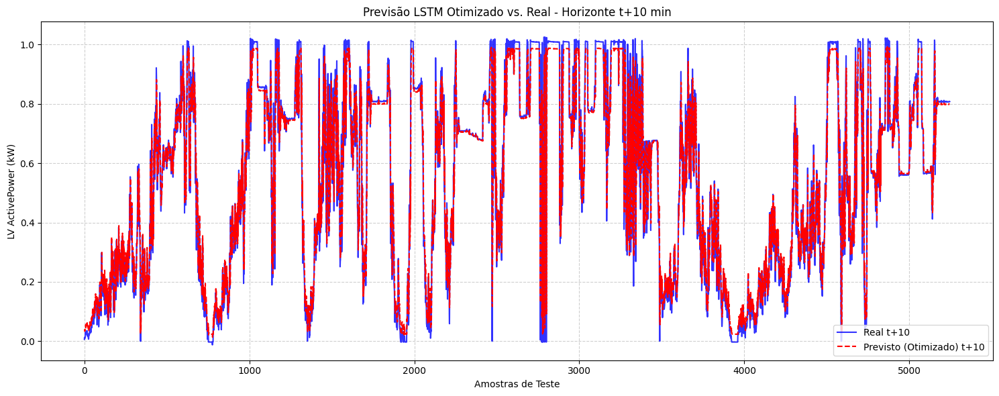

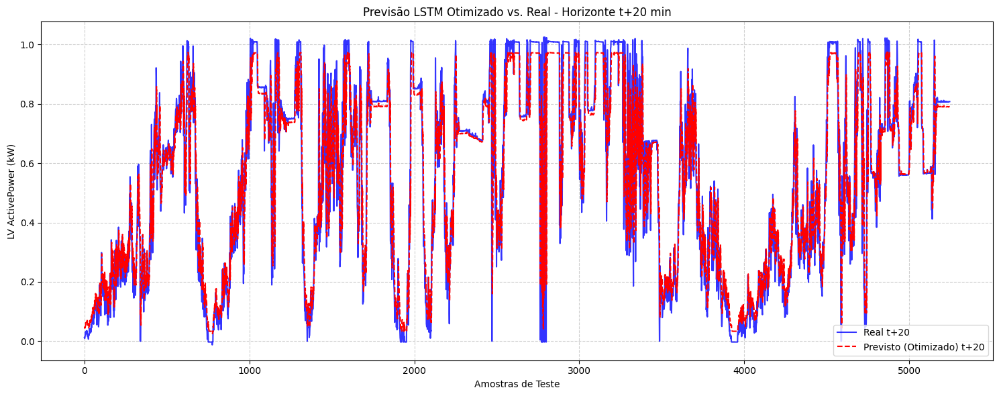

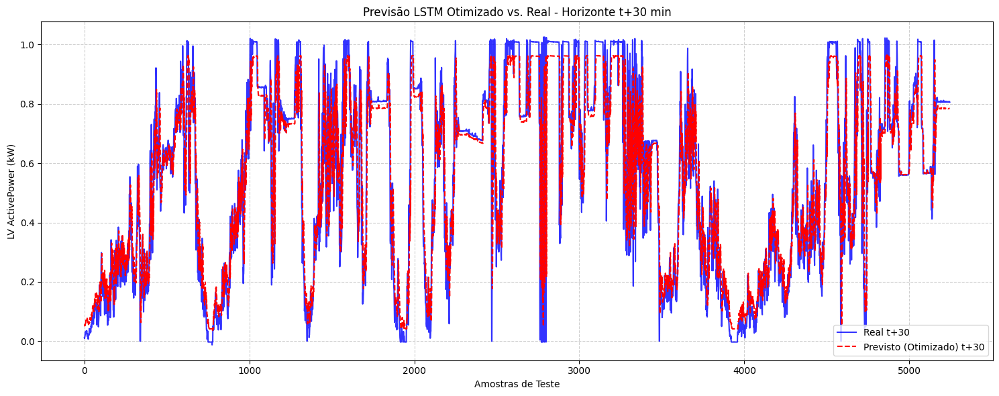

(<Sequential name=sequential, built=True>,
 {'lstm_units': 128,
  'dropout_rate': 0.22760734633943003,
  'learning_rate': 0.0009238947460667959,
  'batch_size': 128},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.781193   0.080940  0.049227  0.935221
 1  t+20 min  6.678083   0.110806  0.068758  0.878541
 2  t+30 min  7.806764   0.124549  0.080378  0.846479)

In [15]:
lstm_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO BI-LSTM EM MODO DE TREINamento ---
Treinando modelo Bi-LSTM para o quantil: 0.1


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo Bi-LSTM salvo em: saved_models/bilstm_model/model_q01.keras
Treinando modelo Bi-LSTM para o quantil: 0.5


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step
Modelo Bi-LSTM salvo em: saved_models/bilstm_model/model_q05.keras
Treinando modelo Bi-LSTM para o quantil: 0.9


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo Bi-LSTM salvo em: saved_models/bilstm_model/model_q09.keras
Scalers para Bi-LSTM salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas Bi-LSTM (baseadas na previsão da mediana q=0.5) =====
Horizonte t+10: MAPE=4.4079%, RMSE=0.0817, MAE=0.0454, R²=0.9340
Horizonte t+20: MAPE=6.0923%, RMSE=0.1121, MAE=0.0627, R²=0.8757
Horizonte t+30: MAPE=7.0966%, RMSE=0.1264, MAE=0.0731, R²=0.8420


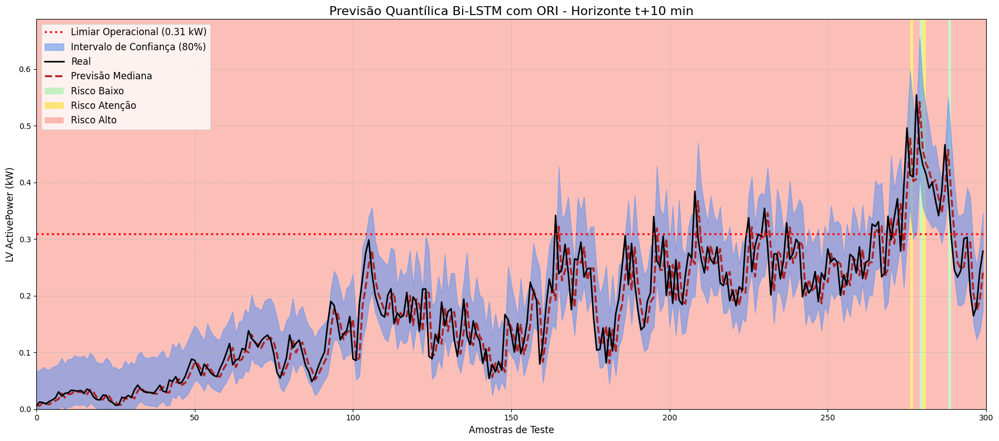

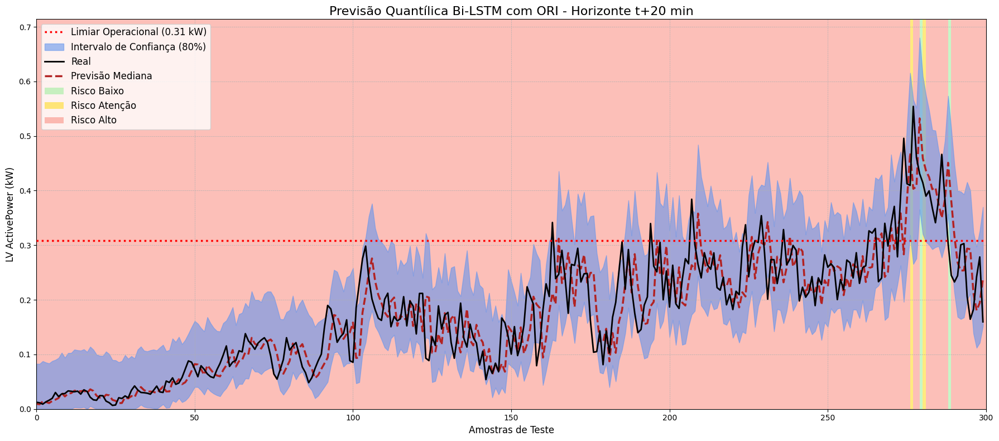

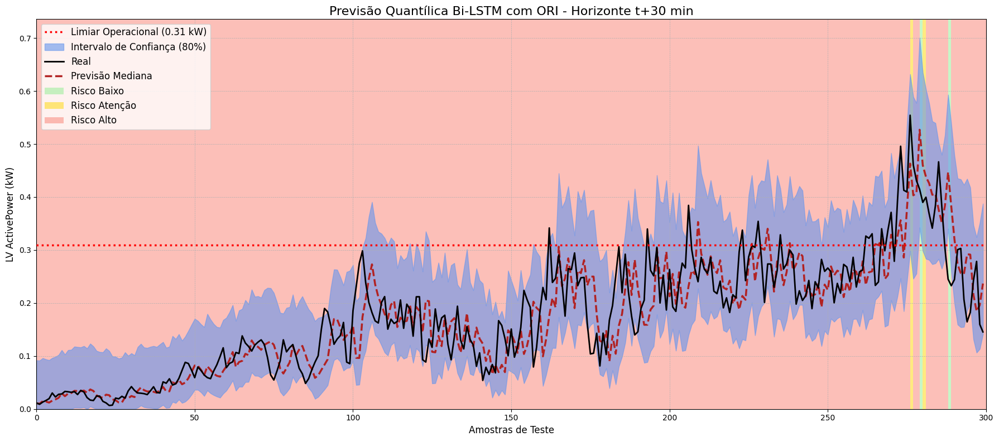

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7727961 , 0.76197064, 0.7397739 ],
         [0.77273685, 0.761989  , 0.73980224],
         [0.7725214 , 0.7618648 , 0.7397056 ]], dtype=float32),
  0.5: array([[0.00633046, 0.00948457, 0.01084593],
         [0.00559062, 0.00868107, 0.0100168 ],
         [0.01146719, 0.01394455, 0.01494762],
         ...,
         [0.80866826, 0.8085543 , 0.8077757 ],
         [0.8085057 , 0.8084219 , 0.8076587 ],
         [0.80821466, 0.8081563 , 0.80740595]], dtype=float32),
  0.9: array([[0.06763667, 0.08278088, 0.09175381],
         [0.06784081, 0.0826156 , 0.09143311],
         [0.07399148, 0.08767243, 0.09603125],
         ...,
         [0.8856025 , 0.90074545, 0.9103553 ],
         [0.8855207 , 0.9006782 , 0.9102902 ],
         [0.8853596 , 0.900539  , 0.91015667]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [22]:
bilstm_model(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 14:43:01,697] A new study created in memory with name: no-name-1459e8aa-fa85-4338-8133-d7bef19e1533


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO BI-LSTM ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA BI-LSTM COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:46:14,030] Trial 0 finished with value: 5.709847246727729 and parameters: {'lstm_units': 128, 'dropout_rate': 0.3036615511287247, 'learning_rate': 0.00042423771913823003, 'batch_size': 64}. Best is trial 0 with value: 5.709847246727729.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:48:08,446] Trial 1 finished with value: 6.155321027808767 and parameters: {'lstm_units': 256, 'dropout_rate': 0.25873984172526343, 'learning_rate': 0.00264814570431111, 'batch_size': 32}. Best is trial 0 with value: 5.709847246727729.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:53:49,539] Trial 2 finished with value: 5.84046063481414 and parameters: {'lstm_units': 64, 'dropout_rate': 0.24702237553234735, 'learning_rate': 0.00022613867831659454, 'batch_size': 32}. Best is trial 0 with value: 5.709847246727729.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:56:07,736] Trial 3 finished with value: 5.697335398518743 and parameters: {'lstm_units': 256, 'dropout_rate': 0.477515696323463, 'learning_rate': 0.0013141469901791825, 'batch_size': 128}. Best is trial 3 with value: 5.697335398518743.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 14:58:17,017] Trial 4 finished with value: 6.155565032481191 and parameters: {'lstm_units': 128, 'dropout_rate': 0.407209970273954, 'learning_rate': 0.0030439340592511225, 'batch_size': 64}. Best is trial 3 with value: 5.697335398518743.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:00:07,277] Trial 5 finished with value: 5.68192851946515 and parameters: {'lstm_units': 256, 'dropout_rate': 0.34511301247630893, 'learning_rate': 0.0004326397534190421, 'batch_size': 128}. Best is trial 5 with value: 5.68192851946515.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:03:48,588] Trial 6 finished with value: 6.050147774686606 and parameters: {'lstm_units': 64, 'dropout_rate': 0.30720304107010776, 'learning_rate': 0.001392609248236219, 'batch_size': 32}. Best is trial 5 with value: 5.68192851946515.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:06:46,254] Trial 7 finished with value: 5.826598289986674 and parameters: {'lstm_units': 128, 'dropout_rate': 0.11823314567983445, 'learning_rate': 0.00012867550368077493, 'batch_size': 128}. Best is trial 5 with value: 5.68192851946515.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:07:57,811] Trial 8 finished with value: 5.812367099470134 and parameters: {'lstm_units': 32, 'dropout_rate': 0.34102378762330965, 'learning_rate': 0.003929930132851831, 'batch_size': 128}. Best is trial 5 with value: 5.68192851946515.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:08:54,387] Trial 9 finished with value: 6.033359543522533 and parameters: {'lstm_units': 256, 'dropout_rate': 0.15608258520042667, 'learning_rate': 0.005059843240844864, 'batch_size': 128}. Best is trial 5 with value: 5.68192851946515.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:11:05,089] Trial 10 finished with value: 5.866739416388687 and parameters: {'lstm_units': 32, 'dropout_rate': 0.40730512935236707, 'learning_rate': 0.0003720371641046622, 'batch_size': 128}. Best is trial 5 with value: 5.68192851946515.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:13:03,793] Trial 11 finished with value: 5.671411316933376 and parameters: {'lstm_units': 256, 'dropout_rate': 0.4953601958489752, 'learning_rate': 0.0008850891768378332, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:14:38,973] Trial 12 finished with value: 5.690475163238536 and parameters: {'lstm_units': 256, 'dropout_rate': 0.49750977852385153, 'learning_rate': 0.0006463244832679047, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:16:29,240] Trial 13 finished with value: 5.704117344609613 and parameters: {'lstm_units': 256, 'dropout_rate': 0.40346422882510125, 'learning_rate': 0.0007752923704512266, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:18:45,450] Trial 14 finished with value: 5.845657909886633 and parameters: {'lstm_units': 256, 'dropout_rate': 0.4511371574657662, 'learning_rate': 0.00021370592074171696, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:20:30,673] Trial 15 finished with value: 6.107137994546195 and parameters: {'lstm_units': 256, 'dropout_rate': 0.35811722402110946, 'learning_rate': 0.001696482553294494, 'batch_size': 64}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:22:13,433] Trial 16 finished with value: 5.706213599710831 and parameters: {'lstm_units': 256, 'dropout_rate': 0.21320838301745065, 'learning_rate': 0.0005271782852708889, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:24:57,400] Trial 17 finished with value: 5.846309740100103 and parameters: {'lstm_units': 32, 'dropout_rate': 0.3666637111054235, 'learning_rate': 0.00026327714449441477, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:32:05,416] Trial 18 finished with value: 5.866994496918096 and parameters: {'lstm_units': 64, 'dropout_rate': 0.45356411620212234, 'learning_rate': 0.00012756409151372524, 'batch_size': 32}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:34:52,120] Trial 19 finished with value: 5.8862877635624065 and parameters: {'lstm_units': 256, 'dropout_rate': 0.25941792911595674, 'learning_rate': 0.0010449566689871364, 'batch_size': 64}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:35:41,963] Trial 20 finished with value: 5.803935842200883 and parameters: {'lstm_units': 256, 'dropout_rate': 0.18045951494784762, 'learning_rate': 0.006669975283635852, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:37:04,220] Trial 21 finished with value: 5.735318958210624 and parameters: {'lstm_units': 256, 'dropout_rate': 0.49995856800826555, 'learning_rate': 0.0006957604745221084, 'batch_size': 128}. Best is trial 11 with value: 5.671411316933376.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:38:40,945] Trial 22 finished with value: 5.670355719094438 and parameters: {'lstm_units': 256, 'dropout_rate': 0.44620852093099406, 'learning_rate': 0.0006919915018340192, 'batch_size': 128}. Best is trial 22 with value: 5.670355719094438.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:40:20,806] Trial 23 finished with value: 5.913488379806393 and parameters: {'lstm_units': 256, 'dropout_rate': 0.4354555220442183, 'learning_rate': 0.0020781068250903738, 'batch_size': 128}. Best is trial 22 with value: 5.670355719094438.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:42:19,750] Trial 24 finished with value: 5.667035262177941 and parameters: {'lstm_units': 256, 'dropout_rate': 0.37797400205329756, 'learning_rate': 0.0009463754587277058, 'batch_size': 128}. Best is trial 24 with value: 5.667035262177941.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:44:04,657] Trial 25 finished with value: 5.683399794128079 and parameters: {'lstm_units': 256, 'dropout_rate': 0.3839356988032967, 'learning_rate': 0.0010213220410710093, 'batch_size': 128}. Best is trial 24 with value: 5.667035262177941.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:45:25,458] Trial 26 finished with value: 5.898479516862906 and parameters: {'lstm_units': 32, 'dropout_rate': 0.43712763623479, 'learning_rate': 0.00949004900586189, 'batch_size': 128}. Best is trial 24 with value: 5.667035262177941.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:47:01,926] Trial 27 finished with value: 5.734741841079391 and parameters: {'lstm_units': 64, 'dropout_rate': 0.4719198990983415, 'learning_rate': 0.0009370294532765242, 'batch_size': 128}. Best is trial 24 with value: 5.667035262177941.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:52:57,657] Trial 28 finished with value: 5.868438070018698 and parameters: {'lstm_units': 128, 'dropout_rate': 0.4258327058354078, 'learning_rate': 0.00029296551939515727, 'batch_size': 32}. Best is trial 24 with value: 5.667035262177941.


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


[I 2025-10-24 15:55:55,719] Trial 29 finished with value: 5.837042536818415 and parameters: {'lstm_units': 128, 'dropout_rate': 0.2961074954355092, 'learning_rate': 0.0005262896733363252, 'batch_size': 64}. Best is trial 24 with value: 5.667035262177941.

OTIMIZAÇÃO DO BI-LSTM CONCLUÍDA
Melhor resultado (MAPE médio na validação): 5.6670%

Hiperparâmetros Ótimos Encontrados:
  - lstm_units: 256
  - dropout_rate: 0.37797400205329756
  - learning_rate: 0.0009463754587277058
  - batch_size: 128

--- TREINANDO MODELO BI-LSTM FINAL COM OS MELHORES PARÂMETROS ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 42: early stopping
Restoring model weights from the end of the best epoch: 22.
Treinamento final concluído.

===== MÉTRICAS FINAIS NO CONJUNTO DE TESTE =====
Horizonte t+10: MAPE=4.6369%, RMSE=0.0810, MAE=0.0477, R²=0.9351
Horizonte t+20: MAPE=6.5445%, RMSE=0.1105, MAE=0.0674, R²=0.8792
Horizonte t+30: MAPE=7.7219%, RMSE=0.1240, MAE=0.0795, R²=0.8477

--- GERANDO GRÁFICOS DE RESULTADOS ---


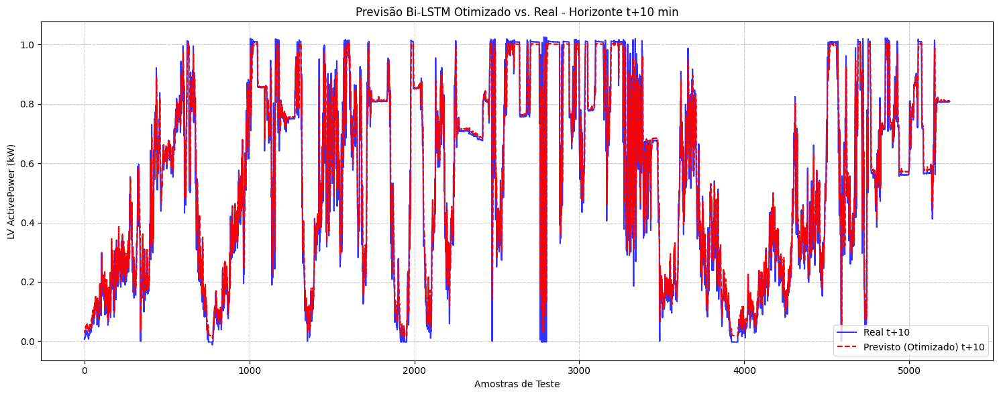

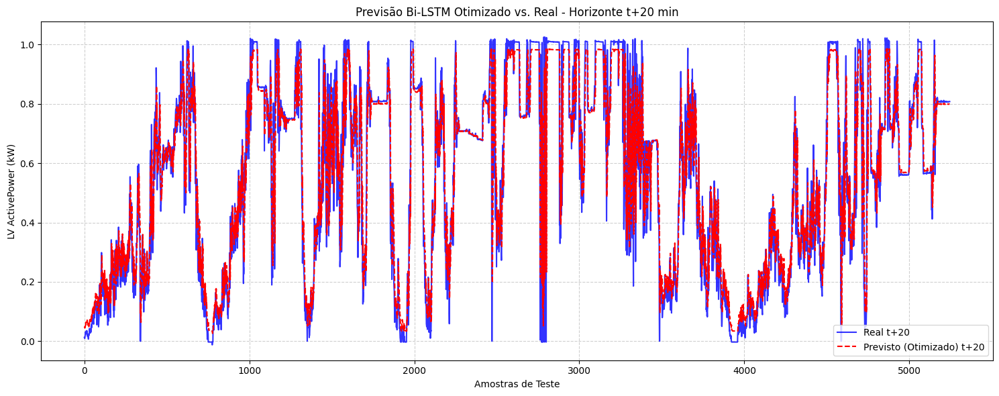

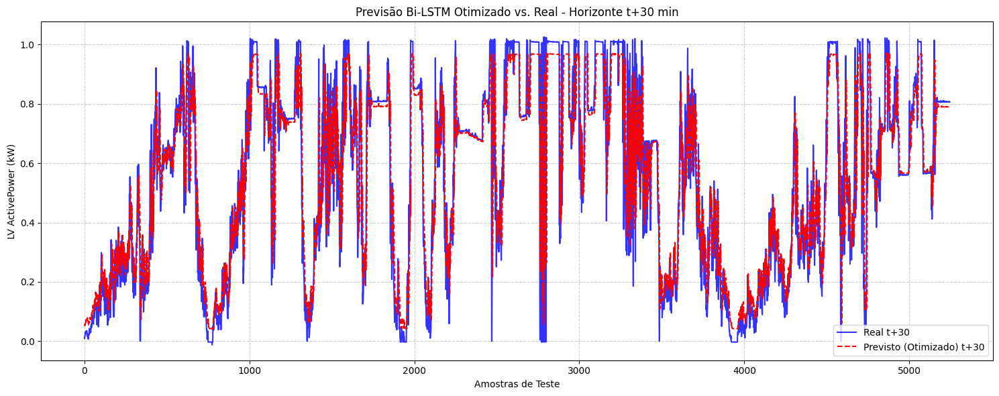

(<Sequential name=sequential, built=True>,
 {'lstm_units': 256,
  'dropout_rate': 0.37797400205329756,
  'learning_rate': 0.0009463754587277058,
  'batch_size': 128},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.636855   0.081005  0.047741  0.935117
 1  t+20 min  6.544453   0.110517  0.067382  0.879176
 2  t+30 min  7.721857   0.124034  0.079504  0.847746)

In [16]:
bilstm_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO BI-LSTM+ATTENTION EM MODO DE TREINAMENTO ---
Treinando modelo Bi-LSTM+Attention para o quantil: 0.1
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo Bi-LSTM+Attention salvo em: saved_models/bilstm_att_model/model_q01.keras
Treinando modelo Bi-LSTM+Attention para o quantil: 0.5
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo Bi-LSTM+Attention salvo em: saved_models/bilstm_att_model/model_q05.keras
Treinando modelo Bi-LSTM+Attention para o quantil: 0.9
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo Bi-LSTM+Attention salvo em: saved_models/bilstm_att_model/model_q09.keras
Scalers para Bi-LSTM+Attention salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas Bi-LSTM+Attention (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=4.6072%, RMSE=0.0823, MAE=0.0474, R²=0.9330
Horizonte t+20: MAPE=6.2033%, RMSE=0.1128, MAE=0.0639, R²=0.8742
Horizonte t+30: MAPE=7.2290%, RMSE=0.1265, MAE=0.0744, R²=0.8415


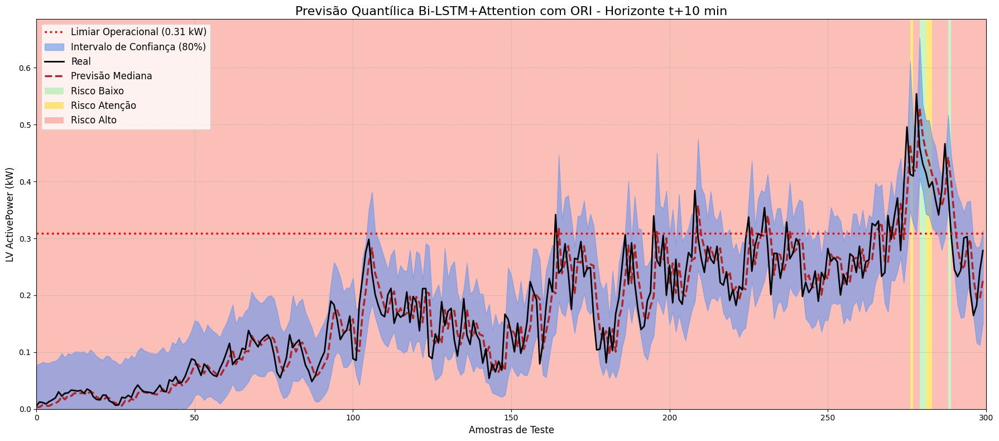

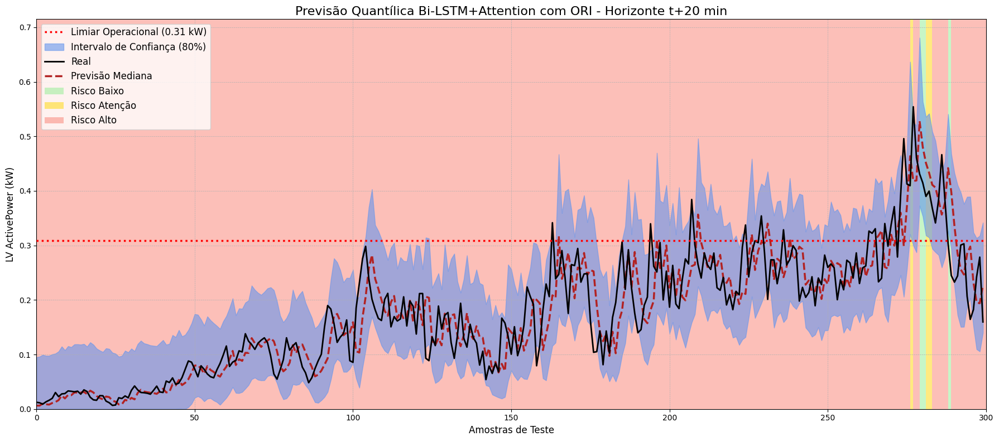

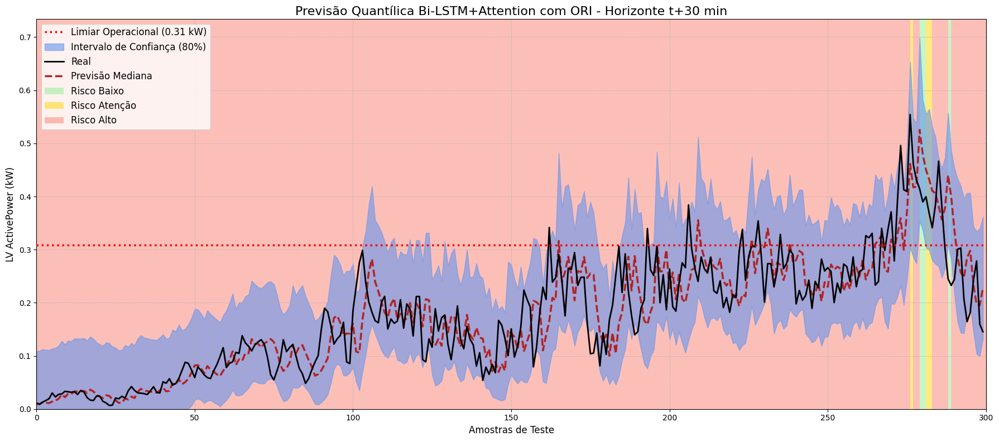

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.74853706, 0.7103908 , 0.6885492 ],
         [0.748484  , 0.7103437 , 0.688505  ],
         [0.7483324 , 0.71019   , 0.6883496 ]], dtype=float32),
  0.5: array([[0.00349128, 0.00622077, 0.00931132],
         [0.00355568, 0.00630085, 0.0093956 ],
         [0.00708106, 0.00975858, 0.01279482],
         ...,
         [0.80817056, 0.8071135 , 0.80341583],
         [0.80808234, 0.8070274 , 0.80333006],
         [0.8078493 , 0.8067968 , 0.8031009 ]], dtype=float32),
  0.9: array([[0.07763606, 0.09490813, 0.10871109],
         [0.07920951, 0.09610958, 0.10966477],
         [0.08256882, 0.0992731 , 0.11267367],
         ...,
         [0.8467582 , 0.86075133, 0.8667207 ],
         [0.84659696, 0.8605984 , 0.8665753 ],
         [0.846363  , 0.86041546, 0.8664268 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [23]:
bilstm_att_model(new_data,i,look_back,data_partition,cap)

In [ ]:
bilstm_att_model_with_optuna(new_data,i,look_back,data_partition,cap)

[I 2025-09-10 09:30:29,612] A new study created in memory with name: no-name-66ded55f-e354-4199-801a-f8428aa1d3d1


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2025-09-10 09:33:52,336] Trial 2 finished with value: 8.985728513999879 and parameters: {'neuron': 64, 'dropout': 0.360776958074578, 'lr': 0.0064259437787493575, 'batch_size': 64}. Best is trial 2 with value: 8.985728513999879.
[I 2025-09-10 09:35:18,080] Trial 0 finished with value: 10.666973086971034 and parameters: {'neuron': 64, 'dropout': 0.14651586010434797, 'lr': 0.0008872575010980295, 'batch_size': 32}. Best is trial 2 with value: 8.985728513999879.
[I 2025-09-10 09:35:25,301] Trial 1 finished with value: 9.19218569759815 and parameters: {'neuron': 64, 'dropout': 0.41616564293544234, 'lr': 0.0022243052648759573, 'batch_size': 16}. Best is trial 2 with value: 8.985728513999879.
[I 2025-09-10 09:35:48,087] Trial 3 finished with value: 10.71484898256773 and parameters: {'neuron': 32, 'dropout': 0.4157428811362119, 'lr': 0.002463177341043669, 'batch_size': 32}. Best is trial 2 with value: 8.985728513999879.
[I 2025-09-10 09:36:43,838] Trial 4 finished with value: 9.0062603302794

--- EXECUTANDO CNN-BI-LSTM EM MODO DE TREINAMENTO ---
Treinando modelo CNN-Bi-LSTM para o quantil: 0.1
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM salvo em: saved_models/cnn_bilstm_model/model_q01.keras
Treinando modelo CNN-Bi-LSTM para o quantil: 0.5
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM salvo em: saved_models/cnn_bilstm_model/model_q05.keras
Treinando modelo CNN-Bi-LSTM para o quantil: 0.9
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM salvo em: saved_models/cnn_bilstm_model/model_q09.keras
Scalers para CNN-Bi-LSTM salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas CNN-Bi-LSTM (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=4.4397%, RMSE=0.0806, MAE=0.0457, R²=0.9358
Horizonte t+20: MAPE=6.0826%, RMSE=0.1116, MAE=0.0626, R²=0.8768
Horizonte t+30: MAPE=7.0887%, RMSE=0.1257, MAE=0.0730, R²=0.8436


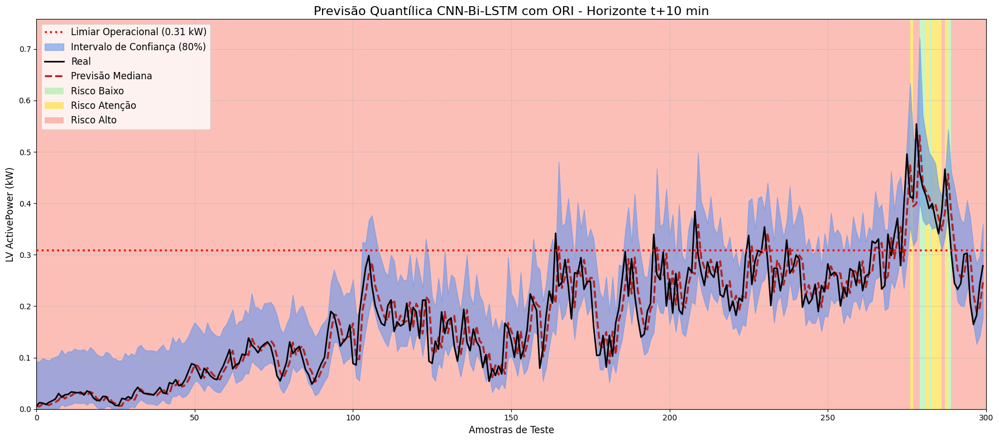

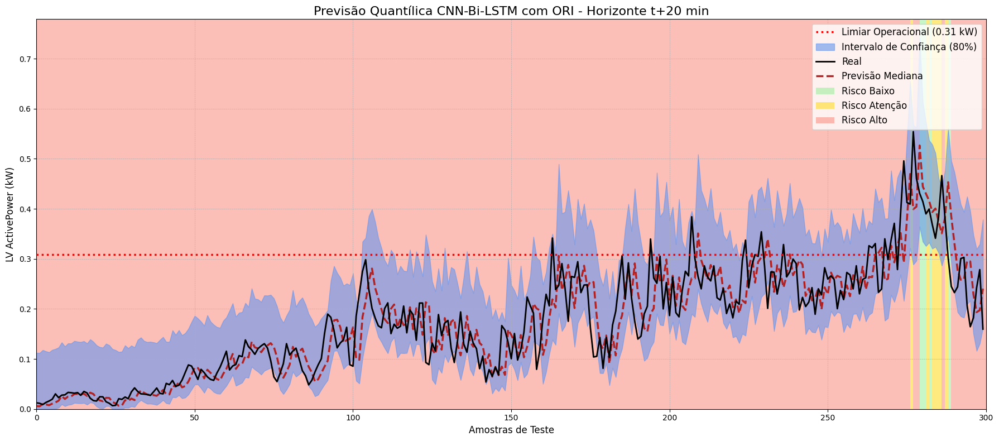

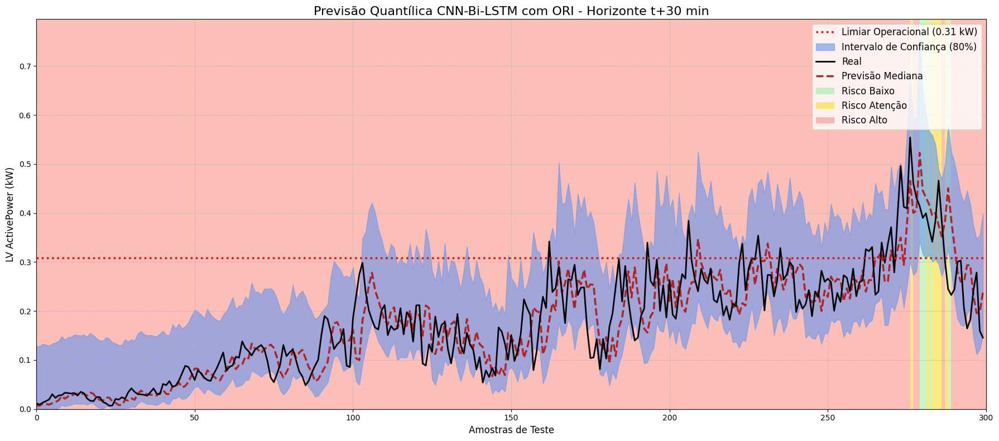

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.757346  , 0.72279555, 0.7099178 ],
         [0.75734055, 0.7228305 , 0.70997053],
         [0.75719434, 0.7227186 , 0.70987505]], dtype=float32),
  0.5: array([[0.00545981, 0.00585739, 0.00720859],
         [0.0050357 , 0.00537152, 0.00669873],
         [0.01010862, 0.00980292, 0.01084325],
         ...,
         [0.8047127 , 0.80987465, 0.8086206 ],
         [0.804575  , 0.8097635 , 0.8085205 ],
         [0.80428565, 0.8094933 , 0.80825853]], dtype=float32),
  0.9: array([[0.09230912, 0.11227544, 0.12813598],
         [0.09208807, 0.11199509, 0.1278272 ],
         [0.09902489, 0.11783077, 0.13321918],
         ...,
         [0.85714483, 0.861706  , 0.8722065 ],
         [0.85702187, 0.8616148 , 0.8721274 ],
         [0.8566983 , 0.8613329 , 0.8718671 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [24]:
cnn_bilstm_model(new_data,i,look_back,data_partition,cap)

[I 2025-10-24 17:29:25,486] A new study created in memory with name: no-name-eccbeb48-3a4f-485f-ab6a-725fc378a15a


--- PREPARANDO DADOS PARA OTIMIZAÇÃO E TREINO DO CNN-BI-LSTM ---
Dados preparados: 21006 amostras de treino, 5246 amostras de teste.

--- INICIANDO BUSCA DE HIPERPARÂMETROS PARA CNN-BI-LSTM COM OPTUNA ---


  0%|          | 0/30 [00:00<?, ?it/s]

I0000 00:00:1761326965.681197   27037 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43629 MB memory:  -> device: 0, name: NVIDIA L40S, pci bus id: 0000:34:00.0, compute capability: 8.9
I0000 00:00:1761326968.204954   29217 cuda_dnn.cc:529] Loaded cuDNN version 90701


[I 2025-10-24 17:37:13,202] Trial 0 finished with value: 5.78077592066447 and parameters: {'cnn_filters': 32, 'kernel_size': 2, 'lstm_units': 32, 'dropout_rate': 0.1482127003873464, 'learning_rate': 0.00010857613498285315, 'batch_size': 64}. Best is trial 0 with value: 5.78077592066447.
[I 2025-10-24 17:40:59,703] Trial 1 finished with value: 5.843369072725953 and parameters: {'cnn_filters': 32, 'kernel_size': 5, 'lstm_units': 64, 'dropout_rate': 0.2103465937623558, 'learning_rate': 0.00039091686061389297, 'batch_size': 64}. Best is trial 0 with value: 5.78077592066447.
[I 2025-10-24 17:43:59,196] Trial 2 finished with value: 5.878061110342664 and parameters: {'cnn_filters': 32, 'kernel_size': 2, 'lstm_units': 64, 'dropout_rate': 0.2575444743300891, 'learning_rate': 0.0002726648091588921, 'batch_size': 64}. Best is trial 0 with value: 5.78077592066447.
[I 2025-10-24 17:45:40,406] Trial 3 finished with value: 6.179004111858177 and parameters: {'cnn_filters': 128, 'kernel_size': 5, 'lstm

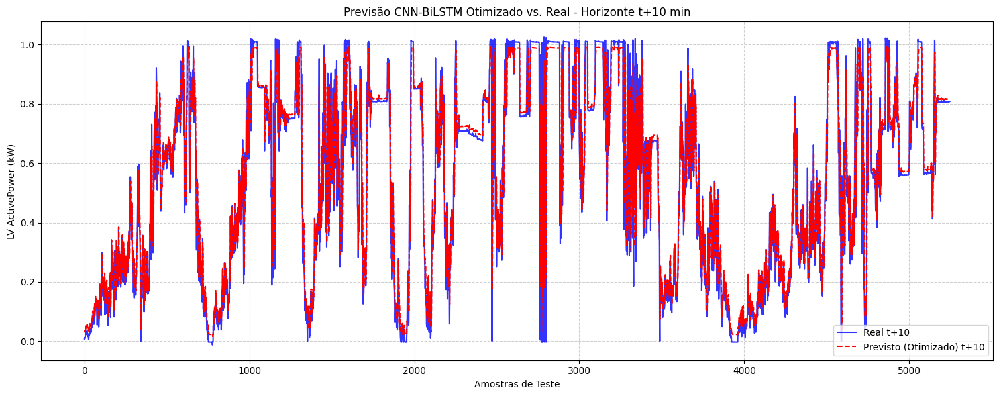

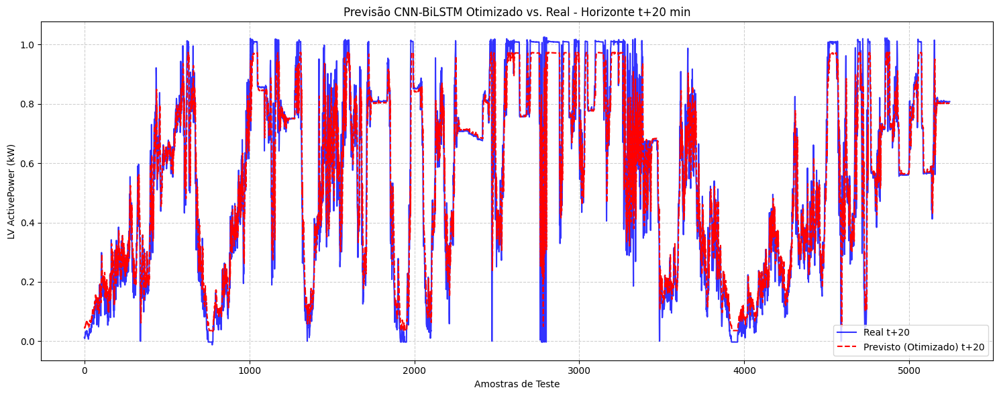

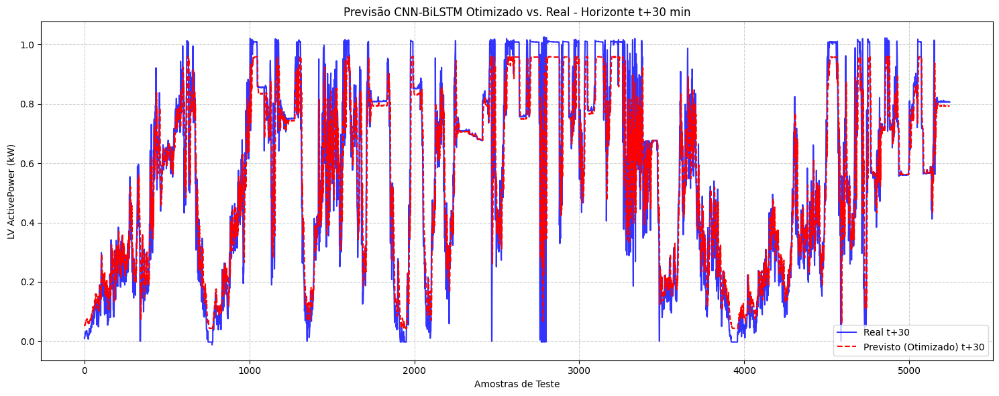

(<Functional name=functional, built=True>,
 {'cnn_filters': 32,
  'kernel_size': 3,
  'lstm_units': 128,
  'dropout_rate': 0.34611204605260304,
  'learning_rate': 0.0006626788668346496,
  'batch_size': 128},
   Horizonte  MAPE (%)  RMSE (MW)  MAE (MW)        R²
 0  t+10 min  4.845998   0.081202  0.049894  0.934802
 1  t+20 min  6.603260   0.109822  0.067987  0.880689
 2  t+30 min  7.710187   0.123206  0.079384  0.849771)

In [12]:
cnn_bilstm_model_with_optuna(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO CNN-BI-LSTM+ATTENTION EM MODO DE TREINAMENTO ---
Treinando modelo CNN-Bi-LSTM+Attention para o quantil: 0.1
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM+Attention salvo em: saved_models/cnn_bilstm_att_model/model_q01.keras
Treinando modelo CNN-Bi-LSTM+Attention para o quantil: 0.5
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM+Attention salvo em: saved_models/cnn_bilstm_att_model/model_q05.keras
Treinando modelo CNN-Bi-LSTM+Attention para o quantil: 0.9
164/164 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step
Modelo CNN-Bi-LSTM+Attention salvo em: saved_models/cnn_bilstm_att_model/model_q09.keras
Scalers para CNN-Bi-LSTM+Attention salvos com sucesso.
Aplicando correção de cruzamento de quantis...

===== Métricas Completas CNN-Bi-LSTM+Attention (baseadas na mediana q=0.5) =====
Horizonte t+10: MAPE=4.5521%, RMSE=0.0813, MAE=0.0469, R²=0.9347
Horizonte t+20: MAPE=6.1719%, RMSE=0.1113, MAE=0.0635, R²=0.8774
Horizonte t+30: MAPE=7.2151%, RMSE=0.1253, MAE=0.0743, 

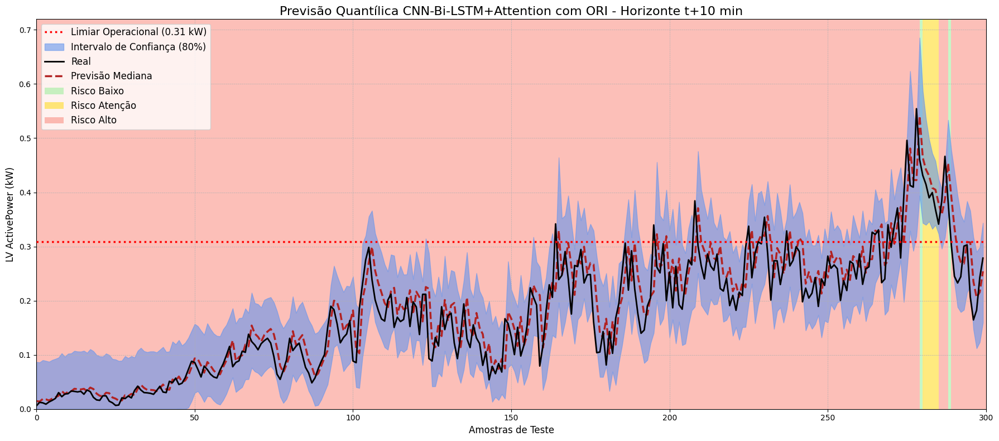

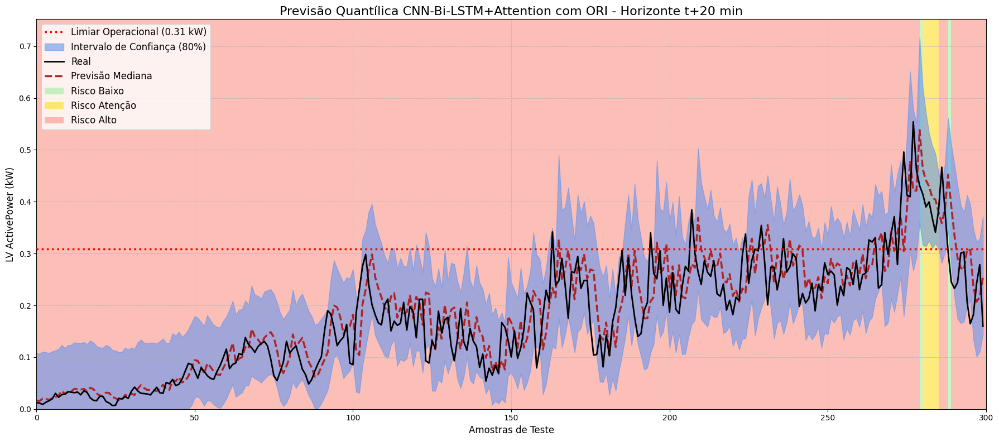

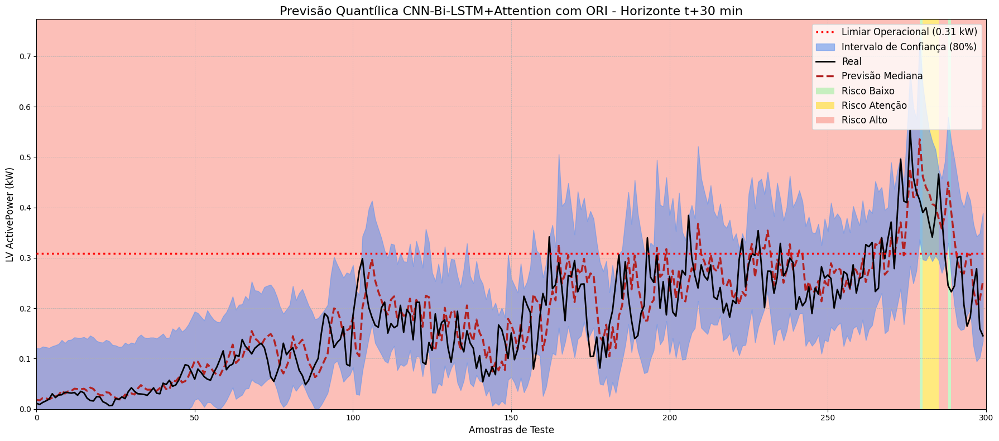

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.75880927, 0.7483197 , 0.7302615 ],
         [0.75895214, 0.74848104, 0.73043376],
         [0.7589282 , 0.74846584, 0.7304249 ]], dtype=float32),
  0.5: array([[0.01470885, 0.01646005, 0.01811582],
         [0.0137881 , 0.01553206, 0.01718852],
         [0.01847214, 0.02013339, 0.02175456],
         ...,
         [0.8061439 , 0.8043923 , 0.8004002 ],
         [0.8060098 , 0.8042628 , 0.8002744 ],
         [0.8057624 , 0.8040208 , 0.8000374 ]], dtype=float32),
  0.9: array([[0.08672428, 0.10739125, 0.12079272],
         [0.08600384, 0.10662229, 0.11999476],
         [0.09013209, 0.11065014, 0.12393415],
         ...,
         [0.83687395, 0.85305816, 0.86323124],
         [0.8367397 , 0.85293245, 0.86311257],
         [0.83645827, 0.8526714 , 0.8628674 ]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [25]:
cnn_bilstm_att_model(new_data,i,look_back,data_partition,cap)

In [ ]:
cnn_bilstm_att_model_with_optuna(new_data,i,look_back,data_partition,cap)

[I 2025-09-10 10:21:29,207] A new study created in memory with name: no-name-2a693072-11f0-4107-af03-aa70ff4e30f7


  0%|          | 0/30 [00:00<?, ?it/s]

27/27 [==============================] - 3s 15ms/step
[I 2025-09-10 10:24:01,520] Trial 5 finished with value: 9.778424843516055 and parameters: {'filters': 32, 'kernel_size': 2, 'neuron': 64, 'dropout': 0.023026967684320665, 'lr': 0.0006297206785311925, 'batch_size': 64}. Best is trial 5 with value: 9.778424843516055.
27/27 [==============================] - 3s 13ms/step
[I 2025-09-10 10:24:02,607] Trial 4 finished with value: 8.38719027372238 and parameters: {'filters': 64, 'kernel_size': 2, 'neuron': 64, 'dropout': 0.08030400313880015, 'lr': 0.0018677629939708768, 'batch_size': 64}. Best is trial 4 with value: 8.38719027372238.
27/27 [==============================] - 2s 7ms/step
[I 2025-09-10 10:24:34,355] Trial 1 finished with value: 8.244922521109274 and parameters: {'filters': 16, 'kernel_size': 3, 'neuron': 16, 'dropout': 0.22106112971694175, 'lr': 0.003467624912897851, 'batch_size': 32}. Best is trial 1 with value: 8.244922521109274.
27/27 [==============================] - 5s

In [ ]:
transformer_model(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO TRANSFORMER (v3) EM MODO DE TREINAMENTO ---
Treinando modelo Transformer (v3) para o quantil: 0.1


In [ ]:
tft_model(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando LSTM para: imf_denoised ---


I0000 00:00:1761016009.032637    3422 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
I0000 00:00:1761016012.249314   69166 cuda_dnn.cc:529] Loaded cuDNN version 90701


--- Q0.1 | Treinando LSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando LSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando LSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando LSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-LSTM) =====
Horizonte t+10: MAPE=1.7658%, RMSE=0.0339, MAE=0.0182, R²=0.9898
Horizonte t+20: MAPE=2.1149%, RMSE=0.0438, MAE=0.0218, R²=0.9830
Horizonte t+30: MAPE=2.4485%, RMSE=0.0488, MAE=0.0252, R²=0.9789


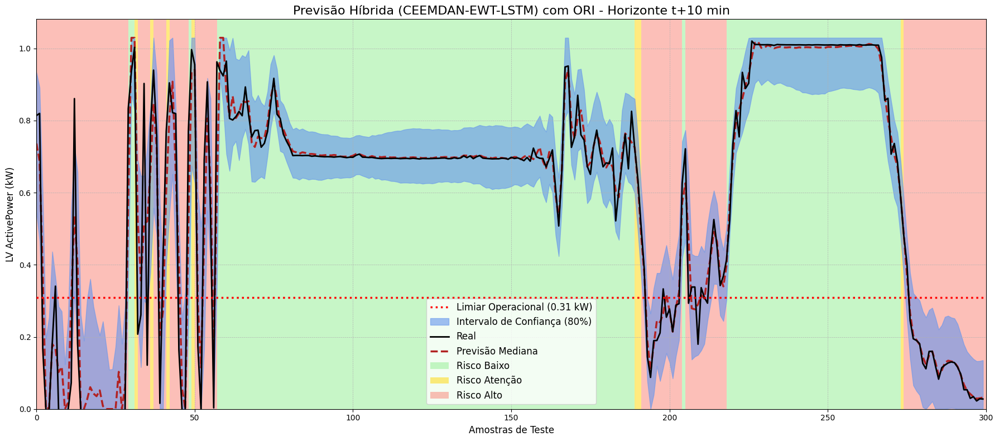

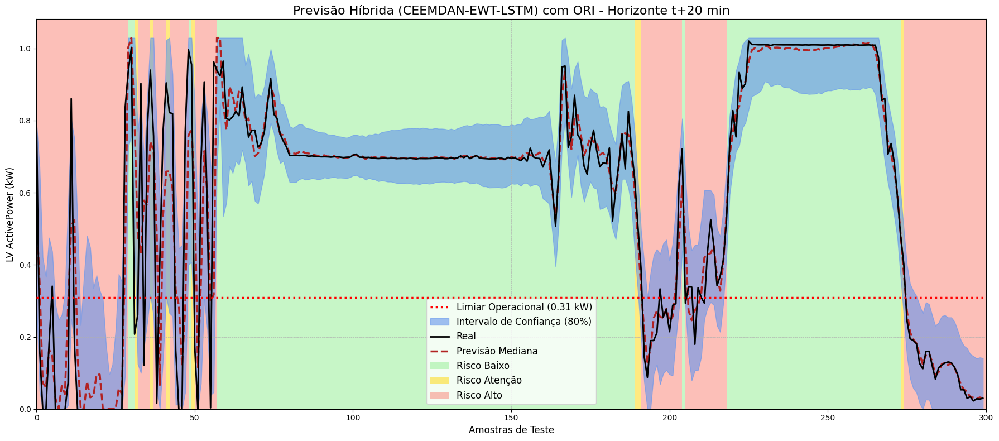

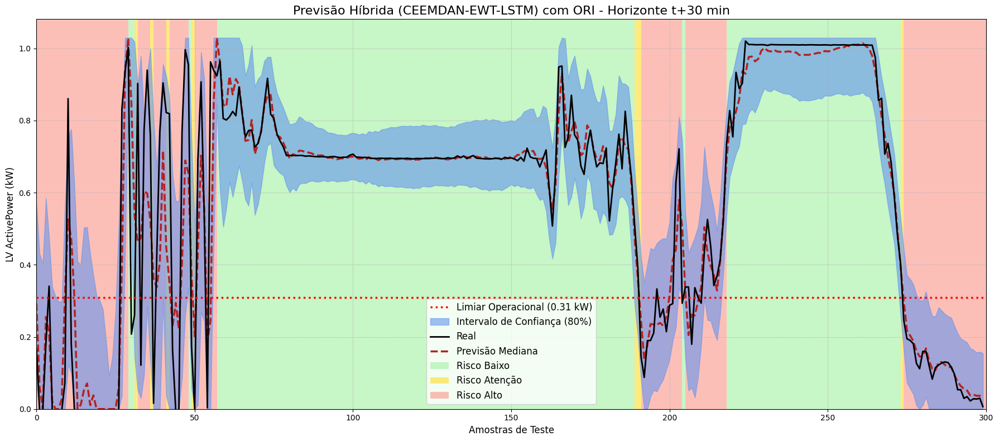

({0.1: array([[0.5466117 , 0.30376765, 0.06476912],
         [0.46643314, 0.05005932, 0.        ],
         [0.16717213, 0.        , 0.        ],
         ...,
         [0.04306042, 0.05223975, 0.06662431],
         [0.04818997, 0.08099392, 0.10012886],
         [0.08400217, 0.11469465, 0.11202747]], dtype=float32),
  0.5: array([[0.7362915 , 0.5344073 , 0.29261425],
         [0.68725955, 0.3528935 , 0.06165552],
         [0.37909067, 0.07228881, 0.        ],
         ...,
         [0.15753406, 0.16455883, 0.1953432 ],
         [0.16275012, 0.1967849 , 0.22805864],
         [0.19893491, 0.2287769 , 0.23329903]], dtype=float32),
  0.9: array([[0.93346435, 0.795502  , 0.5693354 ],
         [0.89177406, 0.6713933 , 0.4301088 ],
         [0.59612685, 0.41943097, 0.40504175],
         ...,
         [0.2541482 , 0.2703623 , 0.31872624],
         [0.2589221 , 0.29897052, 0.3440318 ],
         [0.29345655, 0.32258278, 0.34156865]], dtype=float32)},
 array([[ 0.81396  ,  0.81996  ,  0.16736  ],

In [24]:
proposed_method(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_gru EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando GRU para: imf_denoised ---


I0000 00:00:1761102205.425632   22598 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
I0000 00:00:1761102208.759336  108059 cuda_dnn.cc:529] Loaded cuDNN version 90701


--- Q0.1 | Treinando GRU para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando GRU para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando GRU para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando GRU para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-GRU) =====
Horizonte t+10: MAPE=1.7696%, RMSE=0.0341, MAE=0.0182, R²=0.9897
Horizonte t+20: MAPE=2.1436%, RMSE=0.0429, MAE=0.0221, R²=0.9837
Horizonte t+30: MAPE=2.5399%, RMSE=0.0489, MAE=0.0262, R²=0.9788


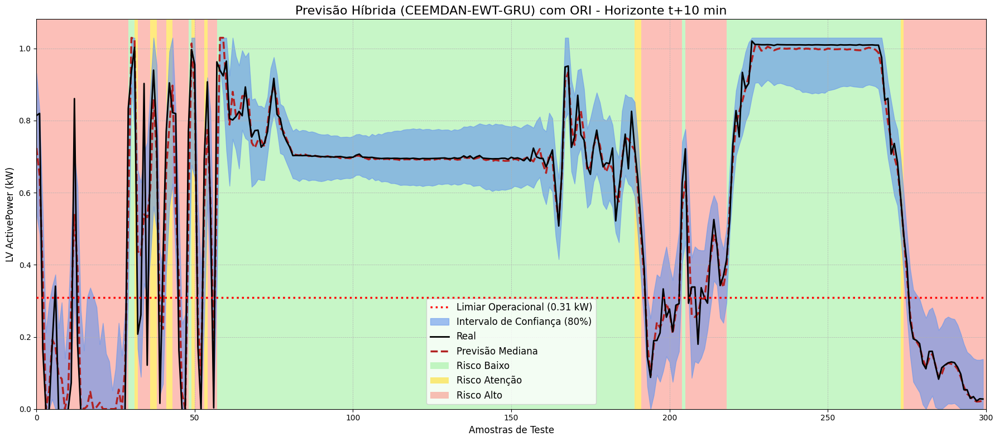

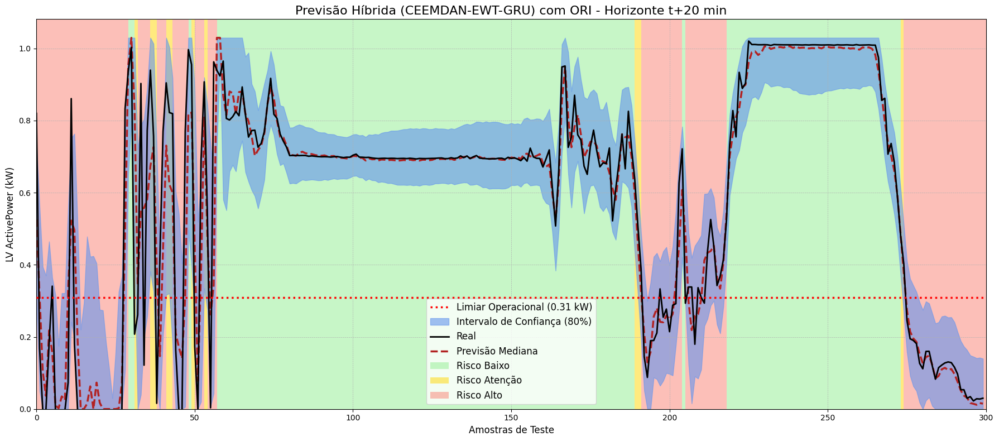

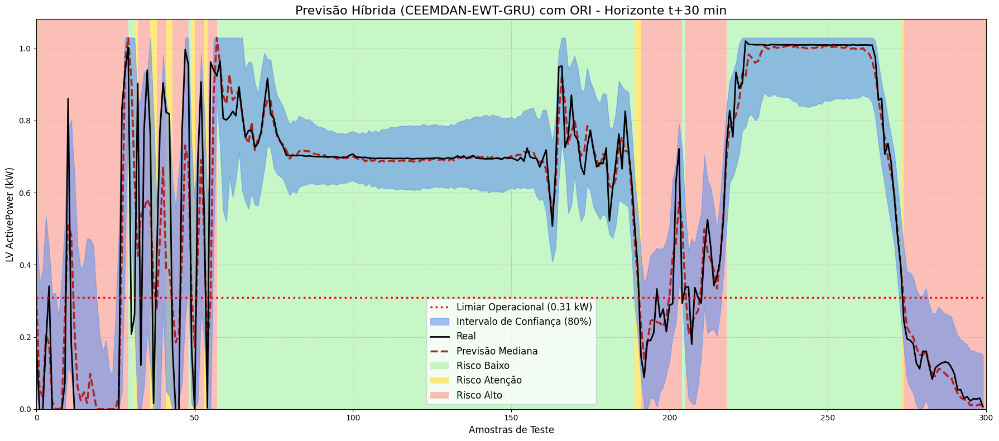

({0.1: array([[0.54440343, 0.29229045, 0.04252392],
         [0.48550808, 0.04878438, 0.        ],
         [0.17621517, 0.        , 0.        ],
         ...,
         [0.05163991, 0.05961546, 0.07338792],
         [0.05560568, 0.08812878, 0.10480869],
         [0.09065297, 0.11927101, 0.11616769]], dtype=float32),
  0.5: array([[0.7237252 , 0.5251895 , 0.30683985],
         [0.6483183 , 0.31446365, 0.05325508],
         [0.37358072, 0.10351774, 0.03448212],
         ...,
         [0.14341253, 0.15682095, 0.19258407],
         [0.14985937, 0.19020335, 0.22505179],
         [0.18543349, 0.22164494, 0.230439  ]], dtype=float32),
  0.9: array([[0.93149215, 0.7409675 , 0.5102117 ],
         [0.82777977, 0.5605437 , 0.34716827],
         [0.5531923 , 0.3942334 , 0.38669813],
         ...,
         [0.24094401, 0.25975305, 0.3080374 ],
         [0.24426633, 0.2879178 , 0.33653688],
         [0.2772552 , 0.3111511 , 0.33448434]], dtype=float32)},
 array([[ 0.81396  ,  0.81996  ,  0.16736  ],

In [12]:
proposed_method_gru(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO (CEEMDAN-EWT)-TFT EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e features salvas.
Construindo e treinando o modelo (CEEMDAN-EWT)-TFT...


I0000 00:00:1761070769.250741  439201 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13949 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_1', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as built, despite not being actually built, which may cause failures down the line. Make sure to implement a proper `build()` method.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/layer.py:421: UserWarning: `build()` was called on layer 'gated_residual_network_2', however the layer does not have a `build()` method implemented and it looks like it has unbuilt state. This will cause the layer to be marked as bui

Modelo TFT Agregador salvo com sucesso.
218/218 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-TFT) =====
Horizonte t+10: MAPE=1.9172%, RMSE=0.0402, MAE=0.0197, R²=0.9857
Horizonte t+20: MAPE=2.3501%, RMSE=0.0493, MAE=0.0242, R²=0.9785
Horizonte t+30: MAPE=2.7255%, RMSE=0.0557, MAE=0.0281, R²=0.9725


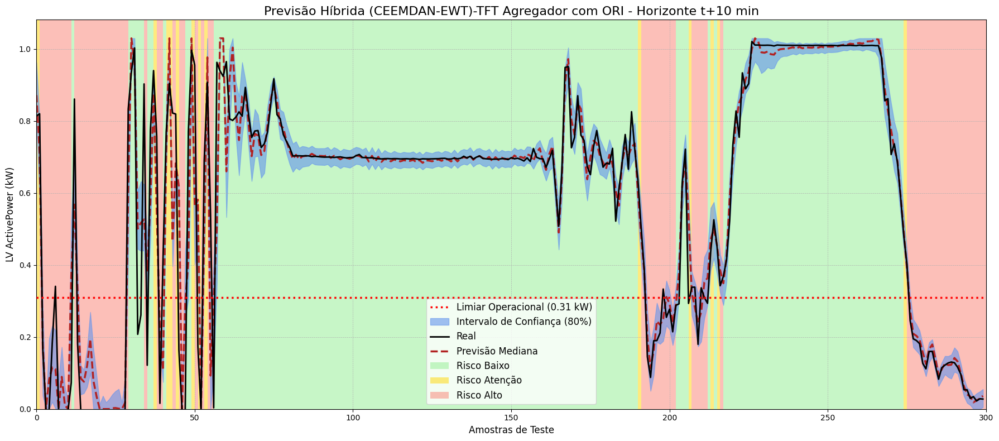

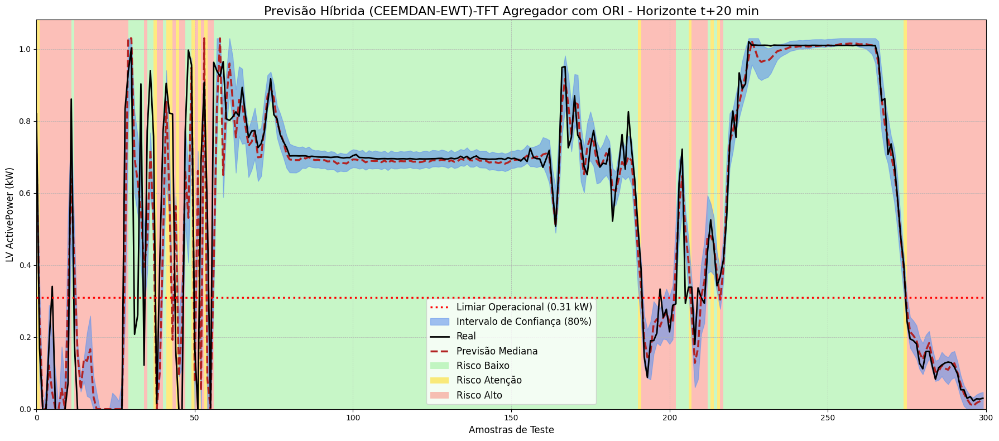

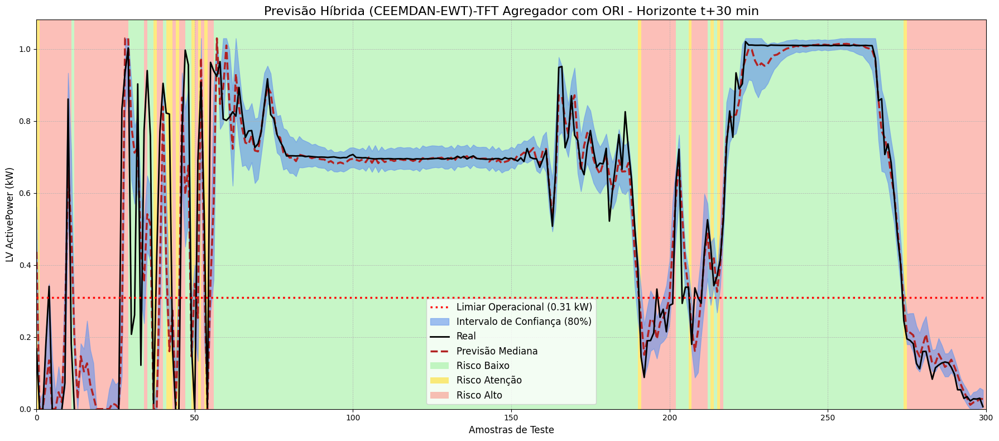

({0.1: array([[0.78953993, 0.5835244 , 0.29403755],
         [0.58264726, 0.07445369, 0.        ],
         [0.0373264 , 0.        , 0.        ],
         ...,
         [0.1283403 , 0.12065605, 0.15436414],
         [0.12864885, 0.14860925, 0.19130331],
         [0.16503868, 0.18201509, 0.19717555]], dtype=float32),
  0.5: array([[0.8716622 , 0.7384103 , 0.43651986],
         [0.7122635 , 0.24505638, 0.        ],
         [0.17866454, 0.        , 0.        ],
         ...,
         [0.15450427, 0.15142709, 0.18854707],
         [0.15570796, 0.18307748, 0.23071496],
         [0.1948137 , 0.22164302, 0.2365019 ]], dtype=float32),
  0.9: array([[0.96254164, 0.80174816, 0.5613851 ],
         [0.80689174, 0.34642664, 0.02524761],
         [0.28651357, 0.        , 0.04396525],
         ...,
         [0.17613834, 0.18201014, 0.22036424],
         [0.17844668, 0.22138539, 0.26661175],
         [0.22054371, 0.2582993 , 0.26545197]], dtype=float32)},
 array([[ 0.81396  ,  0.81996  ,  0.16736  ],

In [12]:
proposed_method_tft_aggregator(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_bilstm EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando BiLSTM para: imf_denoised ---


I0000 00:00:1759929371.411961    4389 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 710 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)
I0000 00:00:1759929374.685786  171190 cuda_dnn.cc:529] Loaded cuDNN version 90701


--- Q0.1 | Treinando BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.1 | Treinando BiLSTM para: imf_14 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.5 | Treinando BiLSTM para: imf_14 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--- Q0.9 | Treinando BiLSTM para: imf_14 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-BiLSTM) =====
Horizonte t+10: MAPE=3.4907%, RMSE=0.0447, MAE=0.0359, R²=0.9756
Horizonte t+20: MAPE=3.7871%, RMSE=0.0485, MAE=0.0390, R²=0.9713
Horizonte t+30: MAPE=4.1736%, RMSE=0.0535, MAE=0.0430, R²=0.9651


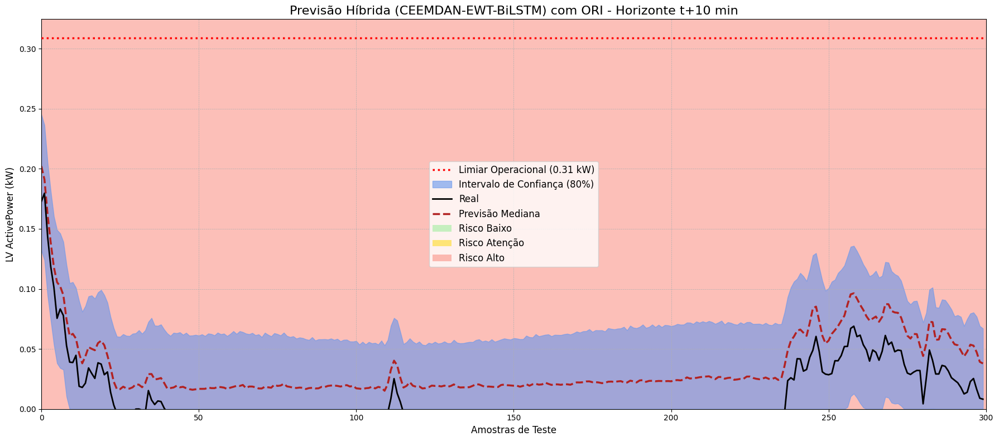

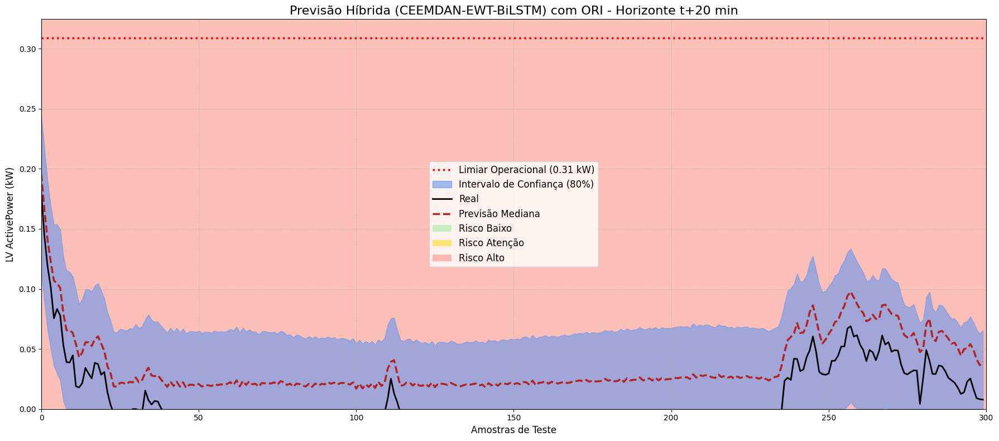

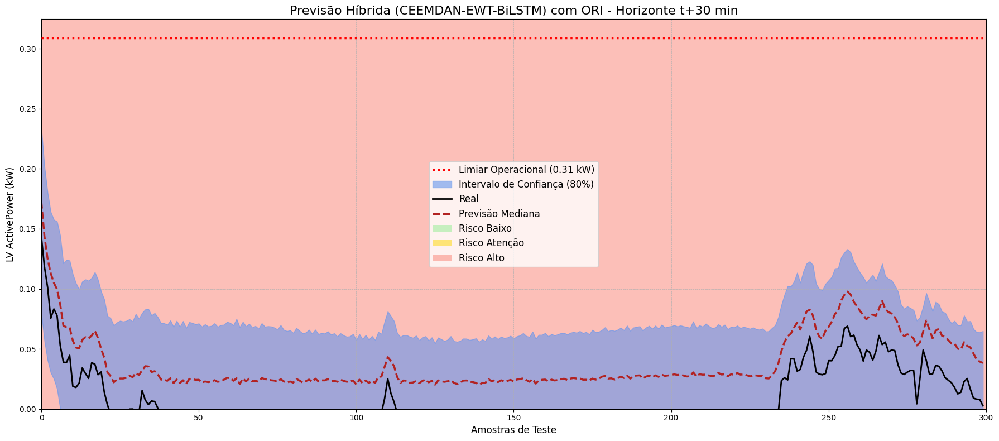

({0.1: array([[0.131996  , 0.11335436, 0.07963879],
         [0.12407845, 0.08881181, 0.05675501],
         [0.09435236, 0.06569313, 0.04056641],
         ...,
         [0.01290351, 0.00928095, 0.        ],
         [0.01381746, 0.00921384, 0.        ],
         [0.01436275, 0.00931323, 0.        ]], dtype=float32),
  0.5: array([[0.20215781, 0.1954564 , 0.17283054],
         [0.19110416, 0.1655759 , 0.14377426],
         [0.16150029, 0.14031315, 0.1249709 ],
         ...,
         [0.06407851, 0.06854828, 0.0744383 ],
         [0.06525832, 0.06855001, 0.07284299],
         [0.06583329, 0.06873807, 0.07310179]], dtype=float32),
  0.9: array([[0.24524963, 0.24492925, 0.23463473],
         [0.23636326, 0.21657987, 0.20214738],
         [0.20515658, 0.1893925 , 0.18031193],
         ...,
         [0.08889589, 0.09239814, 0.09778219],
         [0.08965215, 0.09206624, 0.09631674],
         [0.08986533, 0.09208073, 0.09679893]], dtype=float32)},
 array([[ 0.17266  ,  0.179566 ,  0.143708 ],

In [12]:
proposed_method_bilstm(new_data,i,look_back,data_partition,cap)

In [ ]:
proposed_method_bilstm_att(new_data,i,look_back,data_partition,cap)

--- EXECUTANDO proposed_method_bilstm_att EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando BiLSTM+Attn para: imf_denoised ---


I0000 00:00:1759356941.253930   83896 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 710 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:1e.0, compute capability: 7.5
I0000 00:00:1759356944.963851  100082 cuda_dnn.cc:529] Loaded cuDNN version 90701


--- Q0.1 | Treinando BiLSTM+Attn para: imf_1 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_2 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_3 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_4 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_5 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_6 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_7 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_8 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_9 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_10 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_11 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_12 ---
--- Q0.1 | Treinando BiLSTM+Attn para: imf_13 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_denoised ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_1 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_2 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_3 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_4 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_5 ---
--- Q0.5 | Treinando BiLSTM+Attn para: imf_6 ---
--- Q0.5 

--- EXECUTANDO proposed_method_cnn_bilstm EM MODO DE TREINAMENTO ---
Iniciando decomposição do sinal (CEEMDAN + EWT)...
Decomposição concluída e salva.
--- Q0.1 | Treinando CNN-BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.1 | Treinando CNN-BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.5 | Treinando CNN-BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_denoised ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_1 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_2 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_3 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_4 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_5 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_6 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_7 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_8 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_9 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_10 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_11 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_12 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


--- Q0.9 | Treinando CNN-BiLSTM para: imf_13 ---


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Aplicando correção de cruzamento de quantis...

===== Métricas Completas (CEEMDAN-EWT-CNN-BiLSTM) =====
Horizonte t+10: MAPE=2.5113%, RMSE=0.0358, MAE=0.0259, R²=0.9873
Horizonte t+20: MAPE=2.9400%, RMSE=0.0442, MAE=0.0303, R²=0.9807
Horizonte t+30: MAPE=3.0480%, RMSE=0.0467, MAE=0.0314, R²=0.9784


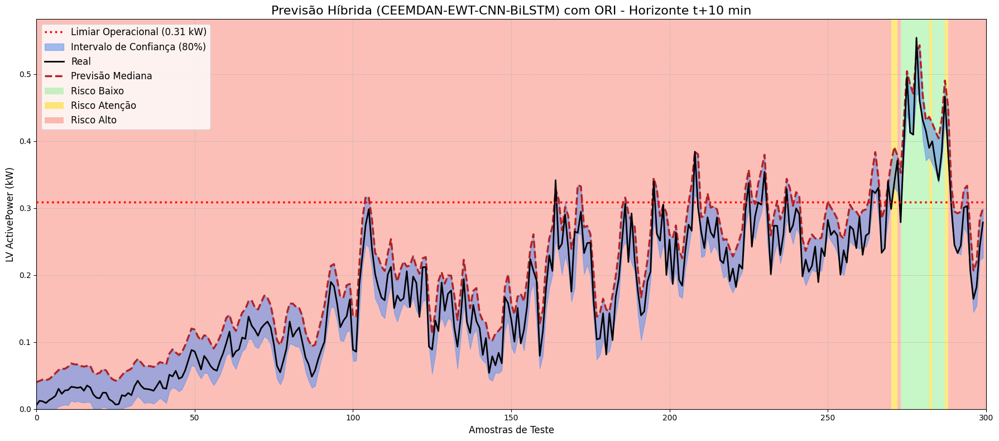

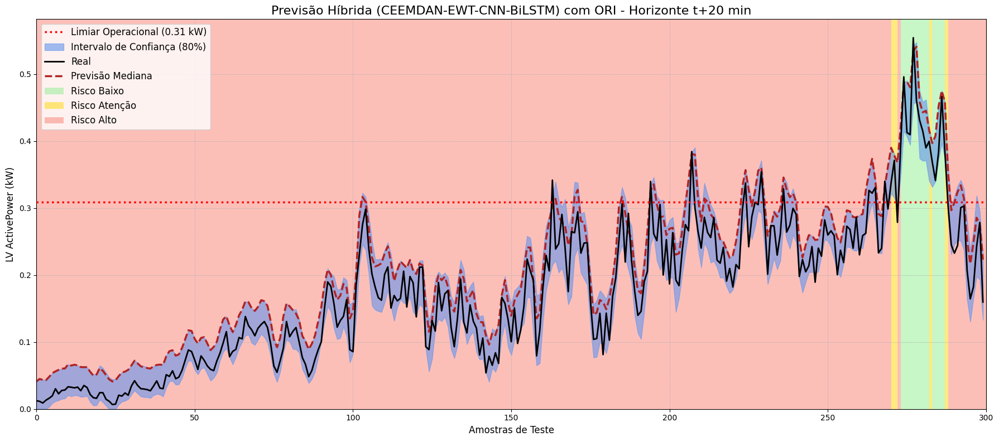

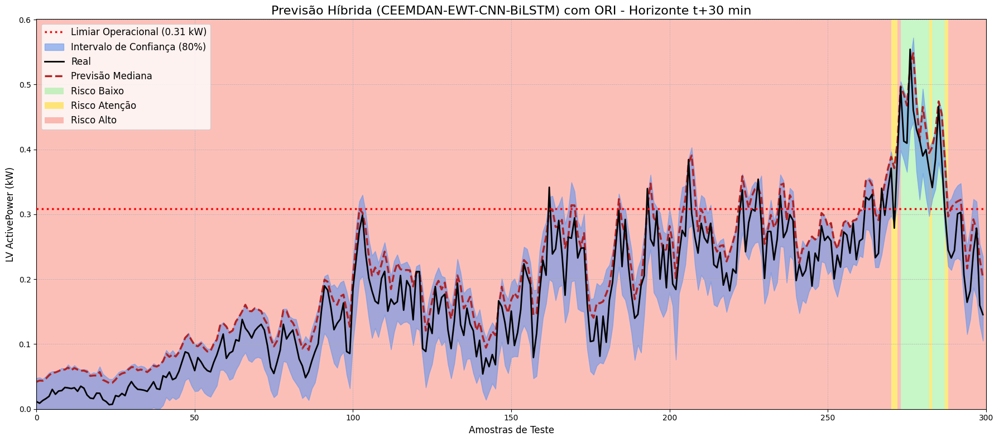

({0.1: array([[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.7259002 , 0.7224294 , 0.71553946],
         [0.72567225, 0.7192731 , 0.7120422 ],
         [0.72399926, 0.7208327 , 0.71482384]], dtype=float32),
  0.5: array([[0.0400618 , 0.04123318, 0.04195887],
         [0.04197386, 0.04498219, 0.04386535],
         [0.04394758, 0.04348204, 0.04352999],
         ...,
         [0.82203805, 0.82211006, 0.8223754 ],
         [0.82118696, 0.8193895 , 0.8202745 ],
         [0.821018  , 0.82076335, 0.82149184]], dtype=float32),
  0.9: array([[0.0400618 , 0.04262322, 0.04774472],
         [0.04197386, 0.04521501, 0.04857129],
         [0.04394758, 0.04390907, 0.04605922],
         ...,
         [0.8546022 , 0.8559399 , 0.86616665],
         [0.85455453, 0.8537974 , 0.8633032 ],
         [0.85357475, 0.854946  , 0.86594105]], dtype=float32)},
 array([[0.0060356, 0.0123626, 0.0114462],
  

In [14]:
proposed_method_cnn_bilstm(new_data,i,look_back,data_partition,cap)

In [ ]:
proposed_method_cnn_bilstm_att(new_data,i,look_back,data_partition,cap)

In [ ]:
proposed_method_lstm_optuna(new_data,i,look_back,data_partition,cap)

[I 2025-08-21 13:21:35,917] A new study created in memory with name: no-name-815516be-66ce-4c4f-9aa2-079f1b4c37fa


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2025-08-21 13:58:37,656] Trial 0 finished with value: 2.8265673420150272 and parameters: {'lstm_units': 32, 'dropout': 0.4852650290539918, 'lr': 0.0010676260610853687, 'batch_size': 16}. Best is trial 0 with value: 2.8265673420150272.


In [ ]:
proposed_method_bilstm_optuna(new_data,i,look_back,data_partition,cap)

In [ ]:
proposed_method_bilstm_att_optuna(new_data,i,look_back,data_partition,cap)

In [45]:
proposed_method_cnn_bilstm_att_optuna(new_data,i,look_back,data_partition,cap)

NameError: name 'proposed_method_cnn_bilstm_att_optuna' is not defined